# Step0：导包 import package

In [13]:
import geopandas as gpd
import matplotlib.pyplot as plt
from matplotlib.colors import TwoSlopeNorm
import numpy as np
import torch
import torchvision.models as models
import torchvision.transforms as transforms
from PIL import Image
import cv2
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score
from sklearn.model_selection import train_test_split

# Step 1: 读取建筑足迹数据

In [14]:
# Step 1: 读取建筑足迹数据
shapefile_path = 'F:/ScientificDatabase/2019年我国建筑轮廓含高度/武汉/武汉/Wuhan_Buildings_DWG-Polygon.shp'
building_footprints = gpd.read_file(shapefile_path)

In [15]:
# 获取建筑足迹数据的边界
xmin, ymin, xmax, ymax = building_footprints.total_bounds

In [16]:
# 计算中心点
x_center = (xmin + xmax) / 2
y_center = (ymin + ymax) / 2

In [17]:
# 定义居中的5km×5km区域
half_size = 2500  # 一半的距离，5km/2 = 2500m
x_min_center = x_center - half_size
x_max_center = x_center + half_size
y_min_center = y_center - half_size
y_max_center = y_center + half_size

In [18]:
# 筛选出居中5km×5km区域的建筑足迹
center_area = building_footprints.cx[x_min_center:x_max_center, y_min_center:y_max_center]

# Step 2: 显示中心区域的建筑足迹

<Figure size 1000x1000 with 0 Axes>

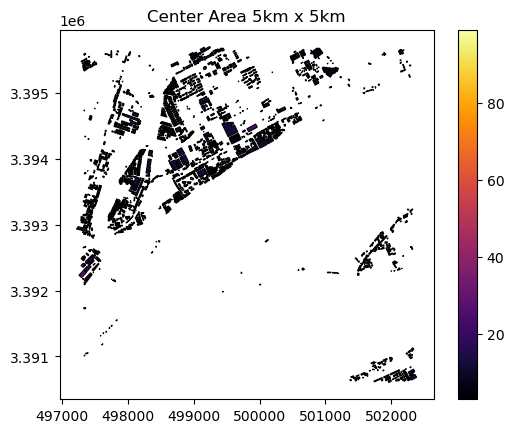

In [19]:
# Step 2: 显示中心区域的建筑足迹
plt.figure(figsize=(10, 10))
center_area.plot(column='Elevation', cmap='inferno', legend=True, linewidth=0.8, edgecolor='black')
plt.title('Center Area 5km x 5km')
plt.show()

In [21]:
# 将中心区域划分成1km×1km的小块
block_size = 1000  # 每块的大小为1km
regions = []
for i in range(5):
    for j in range(5):
        x_min_r = x_min_center + i * block_size
        x_max_r = x_min_center + (i + 1) * block_size
        y_min_r = y_min_center + j * block_size
        y_max_r = y_min_center + (j + 1) * block_size
        regions.append((f"Block {i+1},{j+1}", (x_min_r, x_max_r, y_min_r, y_max_r)))

# Step 3: 处理每个区域的建筑轮廓，并生成图像

C:\Users\asus\AppData\Local\Temp\ipykernel_2612\4239785165.py:21: MatplotlibDeprecationWarning: The tostring_rgb function was deprecated in Matplotlib 3.8 and will be removed two minor releases later. Use buffer_rgba instead.
  image = np.frombuffer(fig.canvas.tostring_rgb(), dtype='uint8').reshape(fig.canvas.get_width_height()[::-1] + (3,))
C:\Users\asus\AppData\Local\Temp\ipykernel_2612\4239785165.py:21: MatplotlibDeprecationWarning: The tostring_rgb function was deprecated in Matplotlib 3.8 and will be removed two minor releases later. Use buffer_rgba instead.
  image = np.frombuffer(fig.canvas.tostring_rgb(), dtype='uint8').reshape(fig.canvas.get_width_height()[::-1] + (3,))
C:\Users\asus\AppData\Local\Temp\ipykernel_2612\4239785165.py:21: MatplotlibDeprecationWarning: The tostring_rgb function was deprecated in Matplotlib 3.8 and will be removed two minor releases later. Use buffer_rgba instead.
  image = np.frombuffer(fig.canvas.tostring_rgb(), dtype='uint8').reshape(fig.canvas.g

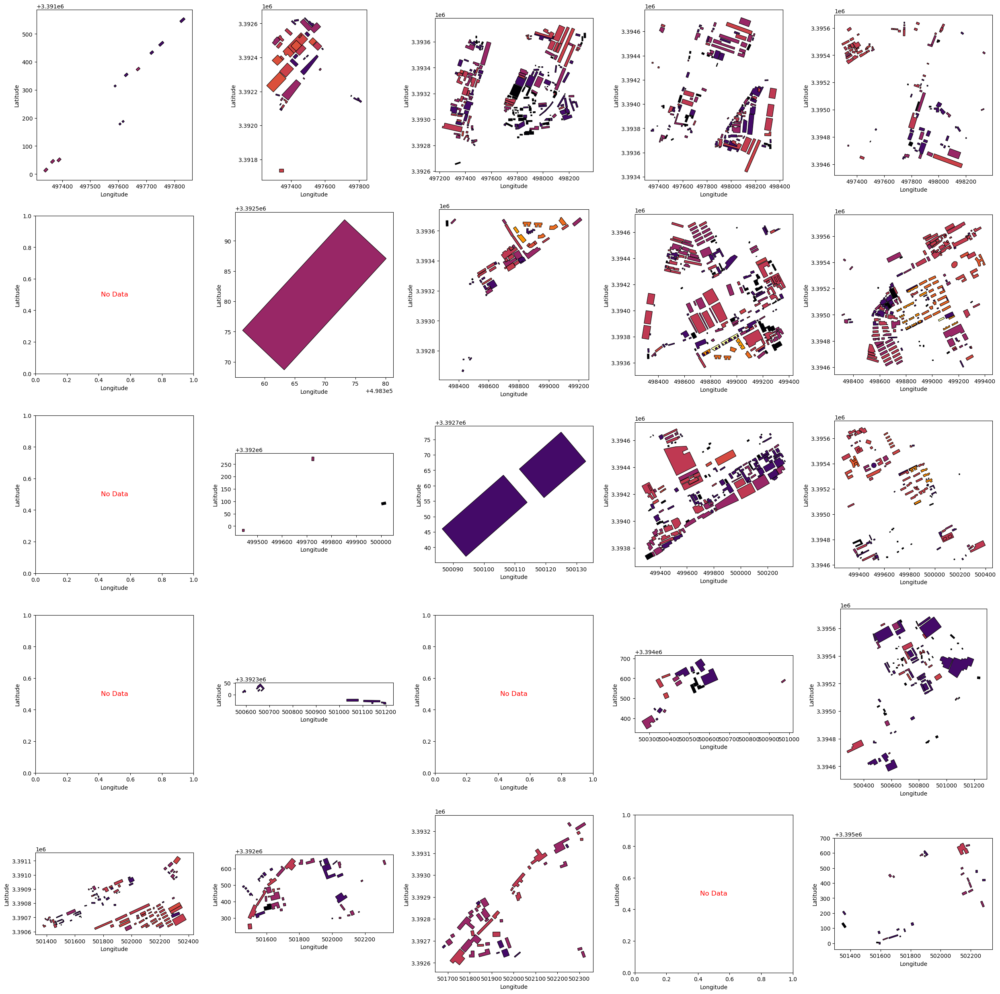

In [22]:
# Step 3: 处理每个区域的建筑轮廓，并生成图像
segmented_images = []
fig, axs = plt.subplots(5, 5, figsize=(25, 25))
axs = axs.flatten()

elevation_values = center_area['Elevation'].dropna()
vmin = elevation_values.min()
vmax = elevation_values.max()
vcenter = elevation_values.mean()

for i, (region_name, (x_min_r, x_max_r, y_min_r, y_max_r)) in enumerate(regions):
    region_ax = axs[i]
    region_area = center_area.cx[x_min_r:x_max_r, y_min_r:y_max_r]

    if not region_area.empty:
        norm = TwoSlopeNorm(vmin=vmin, vcenter=vcenter, vmax=vmax)
        region_area.plot(column='Elevation', ax=region_ax, cmap='inferno', legend=False, linewidth=0.8, edgecolor='black', norm=norm)
        
        # 将子图保存为图像，并加入列表
        fig.canvas.draw()
        image = np.frombuffer(fig.canvas.tostring_rgb(), dtype='uint8').reshape(fig.canvas.get_width_height()[::-1] + (3,))
        segmented_images.append(cv2.cvtColor(image, cv2.COLOR_RGB2BGR))
    else:
        region_ax.text(0.5, 0.5, 'No Data', ha='center', va='center', fontsize=12, color='red')

    region_ax.set_aspect('equal')
    region_ax.set_xlabel("Longitude")
    region_ax.set_ylabel("Latitude")

plt.tight_layout()
plt.show()

# Step 4: 图像处理和特征提取

In [24]:
# # Step 4: 图像处理和特征提取
# transform = transforms.Compose([
#     transforms.Resize(256),
#     transforms.CenterCrop(224),
#     transforms.ToTensor(),
#     transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
# ])

# augmented_images = []
# for idx, seg_img in enumerate(segmented_images):
#     pil_img = Image.fromarray(seg_img)
#     for j in range(3):  # 对每张图像进行3次扩充
#         transformed_image = transform(pil_img).unsqueeze(0)
#         augmented_images.append(transformed_image)

#         # 显示扩充后的图像
#         if j == 0:  # 只展示每个原始图像的第一个扩充版本
#             plt.imshow(transforms.ToPILImage()(transformed_image.squeeze()))
#             plt.title(f'Augmented Image {idx*3 + j+1}')
#             plt.show()


In [25]:
# Step 4: 图像处理和特征提取
transform = transforms.Compose([
    transforms.Resize(256),
    transforms.CenterCrop(224),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])

In [30]:
# augmented_images = []
# for idx, seg_img in enumerate(segmented_images):
#     pil_img = Image.fromarray(seg_img)
    
#     fig, axs = plt.subplots(1, 3, figsize=(15, 5))  # 创建一排3个子图
#     for j in range(3):  # 对每张图像进行3次扩充
#         transformed_image = transform(pil_img).unsqueeze(0)
#         augmented_images.append(transformed_image)

#         # 显示每次扩充的图像
#         axs[j].imshow(transforms.ToPILImage()(transformed_image.squeeze()))
#         axs[j].set_title(f'Augmented Image {idx*3 + j+1}')
#         axs[j].axis('off')
    
#     plt.show()

In [33]:
# # Step 4: 图像处理和特征提取
# transform = transforms.Compose([
#     transforms.Resize(256),
#     transforms.CenterCrop(224),
#     transforms.ToTensor(),
#     transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
# ])

# augmented_images = []
# for idx, seg_img in enumerate(segmented_images):
#     pil_img = Image.fromarray(seg_img)
    
#     # 创建一排3个子图
#     fig, axs = plt.subplots(1, 3, figsize=(15, 5))  
#     for j in range(3):  # 对每张图像进行3次扩充
#         transformed_image = transform(pil_img).unsqueeze(0)
#         augmented_images.append(transformed_image)

#         # 显示每次扩充的图像
#         axs[j].imshow(transforms.ToPILImage()(transformed_image.squeeze()))
#         axs[j].set_title(f'Augmented Image {j+1}')
#         axs[j].axis('off')
    
#     plt.show()
#     break  # 只显示一个segmented_image的扩充效果，跳出循环


In [34]:
# import random

# # Step 4: 图像处理和特征提取
# transform = transforms.Compose([
#     transforms.Resize(256),
#     transforms.CenterCrop(224),
#     transforms.ToTensor(),
#     transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
# ])

# augmented_images = []
# # 随机选择一张图像进行增强
# random_idx = random.randint(0, len(segmented_images) - 1)
# pil_img = Image.fromarray(segmented_images[random_idx])

# # 创建一排3个子图
# fig, axs = plt.subplots(1, 3, figsize=(15, 5))  
# for j in range(3):  # 对随机选中的图像进行3次扩充
#     transformed_image = transform(pil_img).unsqueeze(0)
#     augmented_images.append(transformed_image)

#     # 显示每次扩充的图像
#     axs[j].imshow(transforms.ToPILImage()(transformed_image.squeeze()))
#     axs[j].set_title(f'Augmented Image {j+1}')
#     axs[j].axis('off')

# plt.show()


In [35]:
# Step 4: 图像处理和特征提取
transform = transforms.Compose([
    transforms.Resize(256),
    transforms.CenterCrop(224),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])

In [36]:
augmented_images = []
# 遍历所有分割图像，并对每张图像生成3个增强版本
for idx, seg_img in enumerate(segmented_images):
    pil_img = Image.fromarray(seg_img)

    for j in range(3):  # 对每张图像进行3次扩充
        transformed_image = transform(pil_img).unsqueeze(0)
        augmented_images.append(transformed_image)

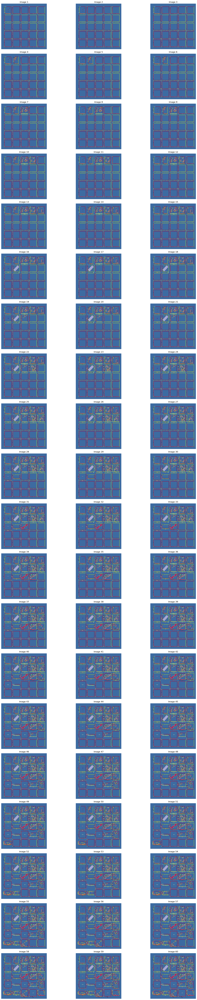

In [37]:
# Step 4: 图像处理和特征提取
transform = transforms.Compose([
    transforms.Resize(256),
    transforms.CenterCrop(224),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])

augmented_images = []

# 遍历所有分割图像，并对每张图像生成3个增强版本
for idx, seg_img in enumerate(segmented_images):
    pil_img = Image.fromarray(seg_img)

    for j in range(3):  # 对每张图像进行3次扩充
        transformed_image = transform(pil_img).unsqueeze(0)
        augmented_images.append(transformed_image)

# 显示生成的全部75张增强图像
num_images = len(augmented_images)
num_cols = 3  # 每行显示3张图片
num_rows = num_images // num_cols

fig, axs = plt.subplots(num_rows, num_cols, figsize=(20, num_rows * 4))
for i in range(num_images):
    row = i // num_cols
    col = i % num_cols
    axs[row, col].imshow(transforms.ToPILImage()(augmented_images[i].squeeze()))
    axs[row, col].axis('off')
    axs[row, col].set_title(f'Image {i+1}')

plt.tight_layout()
plt.show()

In [38]:
# import matplotlib.pyplot as plt
# import torch
# import torchvision.transforms as transforms
# from PIL import Image
# import numpy as np

# # Step 4: 图像处理和特征提取
# transform = transforms.Compose([
#     transforms.Resize(256),
#     transforms.CenterCrop(224),
#     transforms.ToTensor(),
#     transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
# ])

# augmented_images = []

# # 遍历所有分割图像，并对每张图像生成3个增强版本
# for idx, seg_img in enumerate(segmented_images):
#     pil_img = Image.fromarray(seg_img)

#     for j in range(3):  # 对每张图像进行3次扩充
#         transformed_image = transform(pil_img).unsqueeze(0)
#         augmented_images.append(transformed_image)

# # 显示生成的全部75张增强图像
# num_images = len(augmented_images)
# num_cols = 5  # 每行显示5张图片
# num_rows = (num_images + num_cols - 1) // num_cols  # 计算行数

# fig, axs = plt.subplots(num_rows, num_cols, figsize=(20, num_rows * 4))
# for i in range(num_images):
#     row = i // num_cols
#     col = i % num_cols
#     axs[row, col].imshow(transforms.ToPILImage()(augmented_images[i].squeeze()))
#     axs[row, col].axis('off')
#     axs[row, col].set_title(f'Image {i+1}')

# # 隐藏未使用的子图
# for i in range(num_images, num_rows * num_cols):
#     axs[i // num_cols, i % num_cols].axis('off')

# plt.tight_layout()
# plt.show()


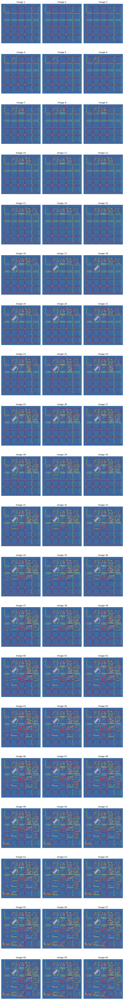

In [41]:
import matplotlib.pyplot as plt
import torch
import torchvision.transforms as transforms
from PIL import Image
import numpy as np

# Step 4: 图像处理和特征提取
transform = transforms.Compose([
    transforms.Resize(256),
    transforms.CenterCrop(224),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])

augmented_images = []

# 遍历所有分割图像，并对每张图像生成3个增强版本
for idx, seg_img in enumerate(segmented_images):
    pil_img = Image.fromarray(seg_img)

    for j in range(3):  # 对每张图像进行3次扩充
        transformed_image = transform(pil_img).unsqueeze(0)
        augmented_images.append(transformed_image)

# 显示生成的全部75张增强图像
num_images = len(augmented_images)
num_cols = 3  # 每行显示3张图片
num_rows = (num_images + num_cols - 1) // num_cols  # 计算行数

fig, axs = plt.subplots(num_rows, num_cols, figsize=(10, num_rows * 4))
for i in range(num_images):
    row = i // num_cols
    col = i % num_cols
    axs[row, col].imshow(transforms.ToPILImage()(augmented_images[i].squeeze()))
    axs[row, col].axis('off')
    axs[row, col].set_title(f'Image {i+1}')

# 隐藏未使用的子图
for i in range(num_images, num_rows * num_cols):
    axs[i // num_cols, i % num_cols].axis('off')

plt.tight_layout()
plt.show()

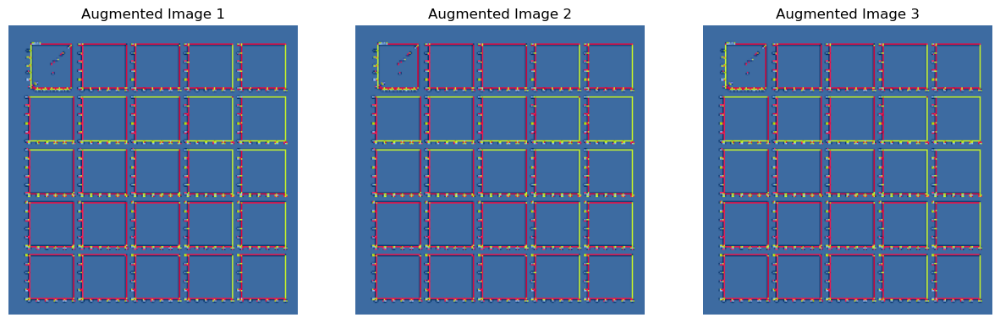

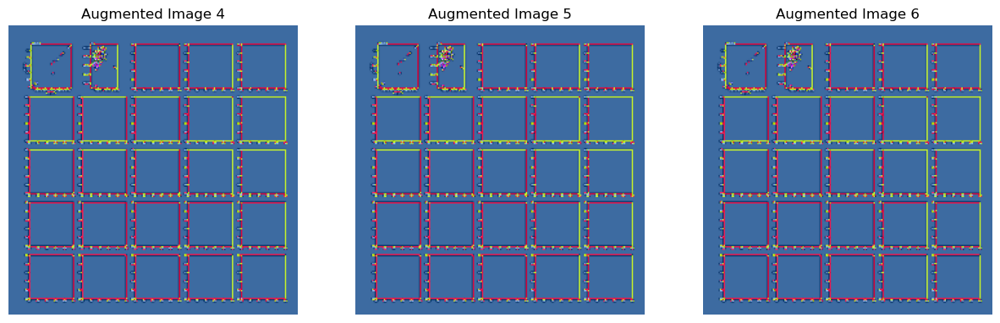

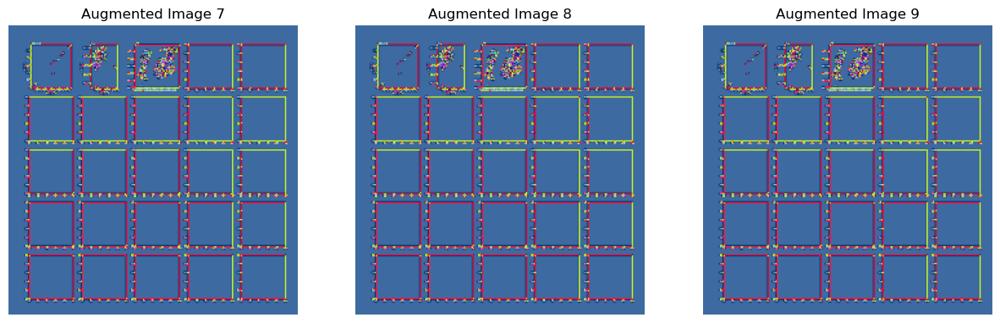

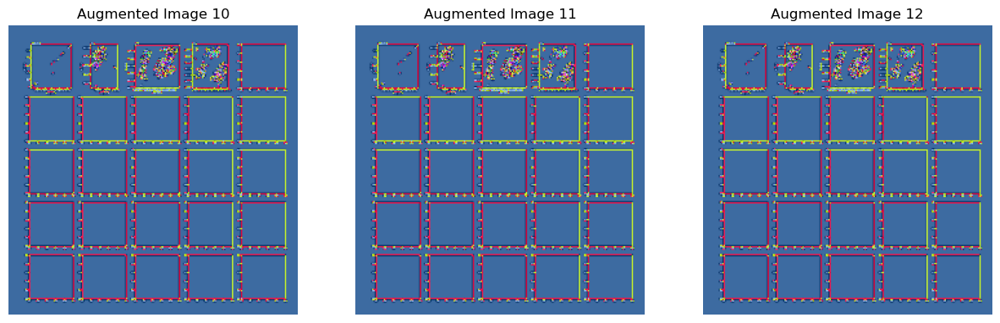

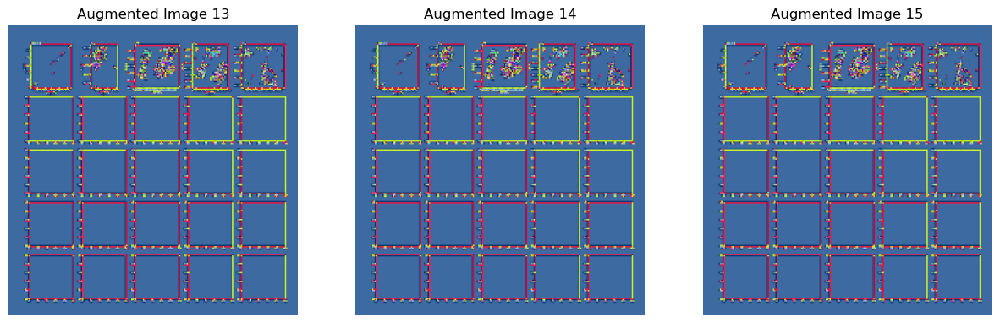

...

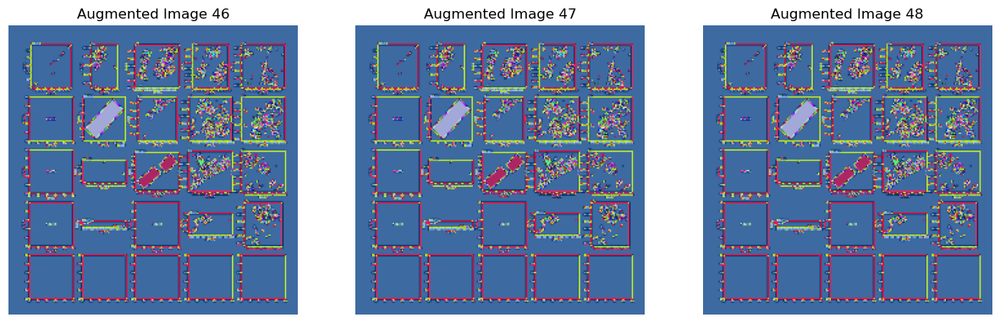

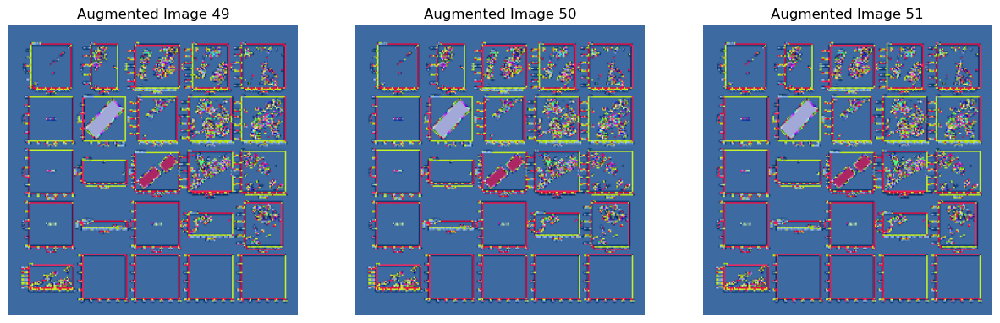

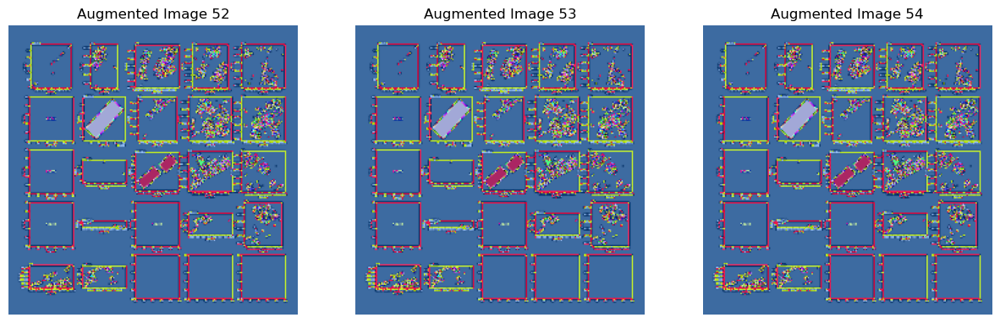

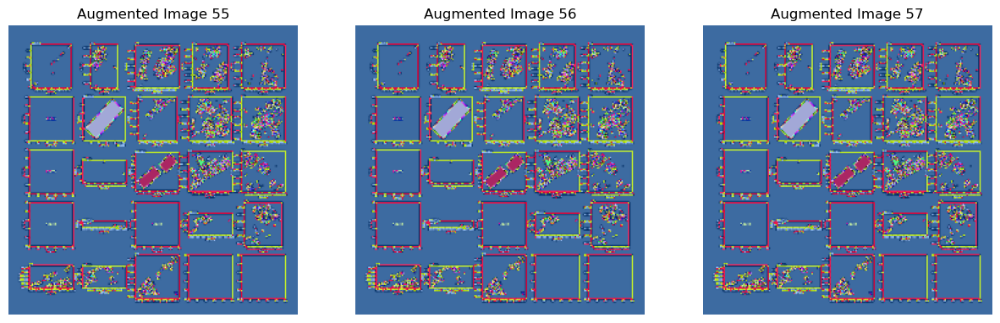

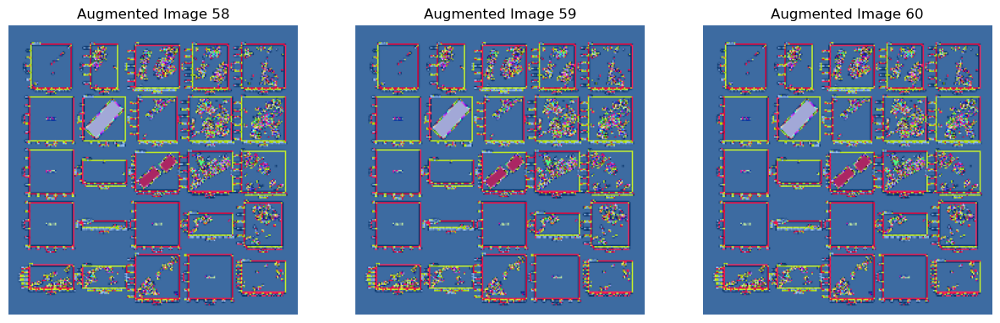

In [42]:
import matplotlib.pyplot as plt
import torch
import torchvision.transforms as transforms
from PIL import Image
import numpy as np

# Step 4: 图像处理和特征提取
transform = transforms.Compose([
    transforms.Resize(256),
    transforms.CenterCrop(224),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])

augmented_images = []

# 遍历所有分割图像，并对每张图像生成3个增强版本
for idx, seg_img in enumerate(segmented_images):
    pil_img = Image.fromarray(seg_img)
    
    # 创建一排3个子图
    fig, axs = plt.subplots(1, 3, figsize=(15, 5))  
    for j in range(3):  # 对每张图像进行3次扩充
        transformed_image = transform(pil_img).unsqueeze(0)
        augmented_images.append(transformed_image)

        # 显示每次扩充的图像
        axs[j].imshow(transforms.ToPILImage()(transformed_image.squeeze()))
        axs[j].set_title(f'Augmented Image {idx*3 + j+1}')
        axs[j].axis('off')
    
    plt.show()

# 继续后续步骤，比如 Step 5...


# Step 5: 使用预训练的 ResNet 模型提取所有增强图像的特征

In [43]:
# Step 5: 使用预训练的 ResNet 模型提取所有增强图像的特征
model = models.resnet50(weights=models.ResNet50_Weights.DEFAULT)
model.eval()
model = torch.nn.Sequential(*list(model.children())[:-2])

all_features = []
for img_tensor in augmented_images:
    with torch.no_grad():
        features = model(img_tensor)
    features_np = features.squeeze().numpy()
    flattened_features = features_np.reshape(features_np.shape[0], -1)
    all_features.append(flattened_features)

In [44]:
# # Step 5: 使用预训练的 ResNet 模型提取所有增强图像的特征
# model = models.resnet50(weights=models.ResNet50_Weights.DEFAULT)
# model.eval()
# model = torch.nn.Sequential(*list(model.children())[:-2])

# all_features = []
# for img_tensor in augmented_images:
#     with torch.no_grad():
#         features = model(img_tensor)
#     features_np = features.squeeze().numpy()
#     flattened_features = features_np.reshape(features_np.shape[0], -1)
#     all_features.append(flattened_features)

# # 将特征数组组合在一起，形成训练集
# X_train = np.vstack(all_features)

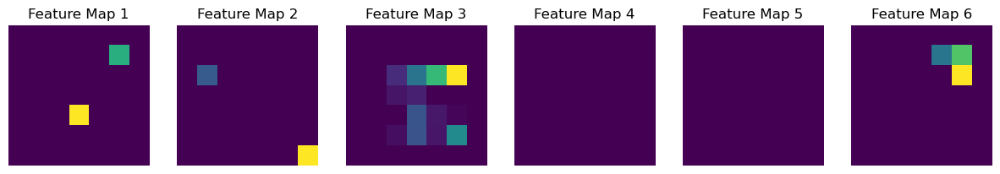

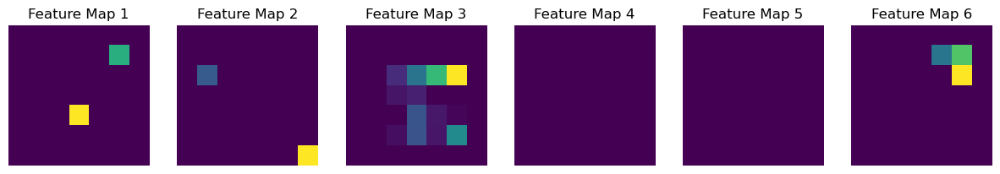

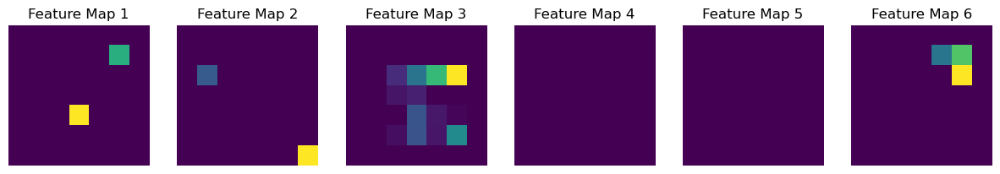

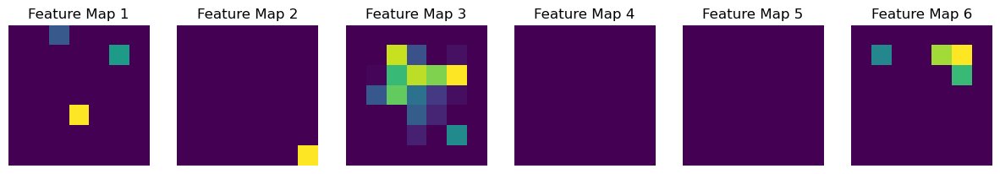

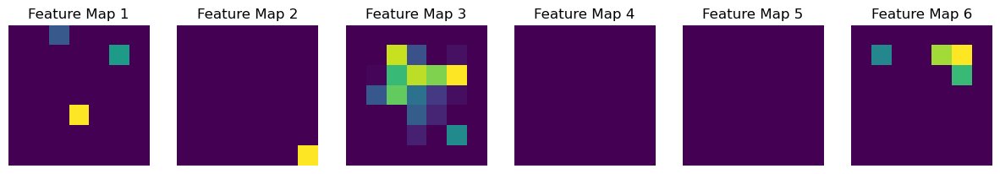

...

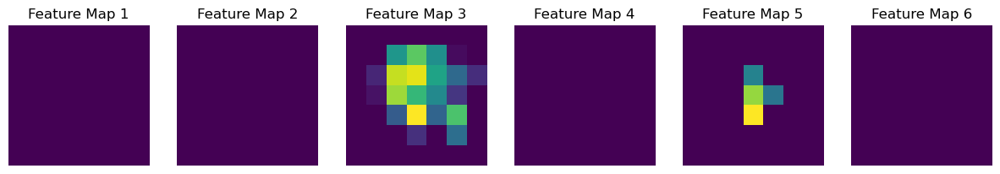

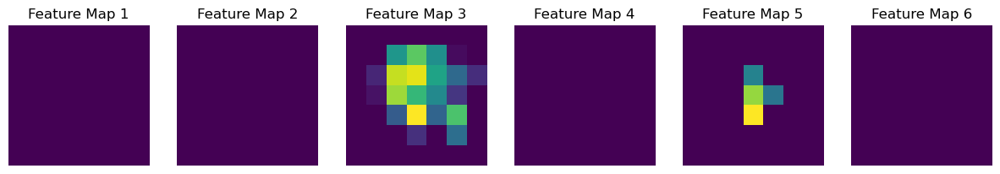

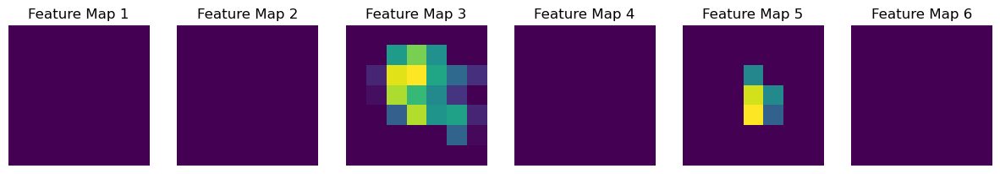

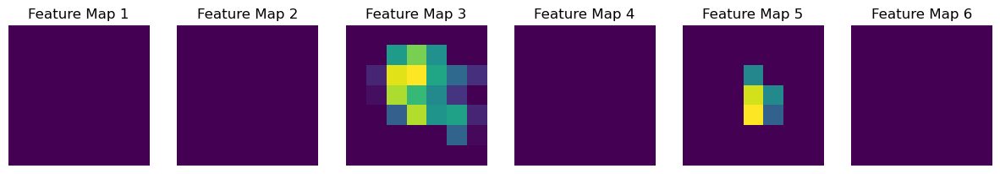

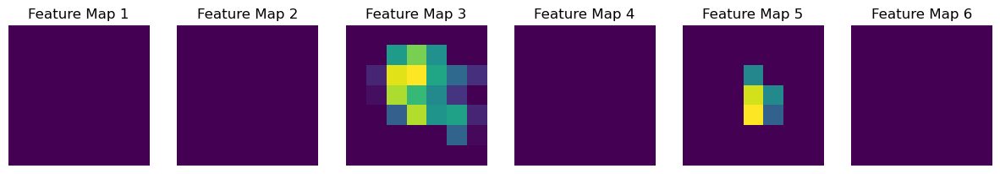

In [45]:
import torch
import torchvision.models as models
import matplotlib.pyplot as plt
import numpy as np

# Step 5: 使用预训练的 ResNet 模型提取所有增强图像的特征
model = models.resnet50(weights=models.ResNet50_Weights.DEFAULT)
model.eval()
model = torch.nn.Sequential(*list(model.children())[:-2])

all_features = []
# 定义要显示的特征图通道数
channels_to_display = 6  # 展示前6个通道的特征图

for img_tensor in augmented_images:
    with torch.no_grad():
        features = model(img_tensor)
    
    # 展示特征图
    features_np = features.squeeze().numpy()

    # 展示前几个通道的特征图
    fig, axs = plt.subplots(1, channels_to_display, figsize=(15, 5))
    for i in range(channels_to_display):
        axs[i].imshow(features_np[i], cmap='viridis')
        axs[i].set_title(f'Feature Map {i+1}')
        axs[i].axis('off')
    plt.show()

    # 将特征展平成一维向量
    flattened_features = features_np.reshape(features_np.shape[0], -1)
    all_features.append(flattened_features)

# 将特征数组组合在一起，形成训练集
X_train = np.vstack(all_features)

## 代码说明01：展示特征图（如上）

1. **展示特征图**：
   - 提取特征后，选择展示部分通道的特征图（例如前6个通道）。这些特征图在 `viridis` 颜色映射下可视化。

2. **特征提取与展示**：
   - 对每个增强后的图像，使用 ResNet 提取特征，并展示部分通道的特征图。

3. **特征展平与组合**：
   - 提取的特征图展平成一维向量，并组合成训练集 `X_train`，供后续分类模型使用。

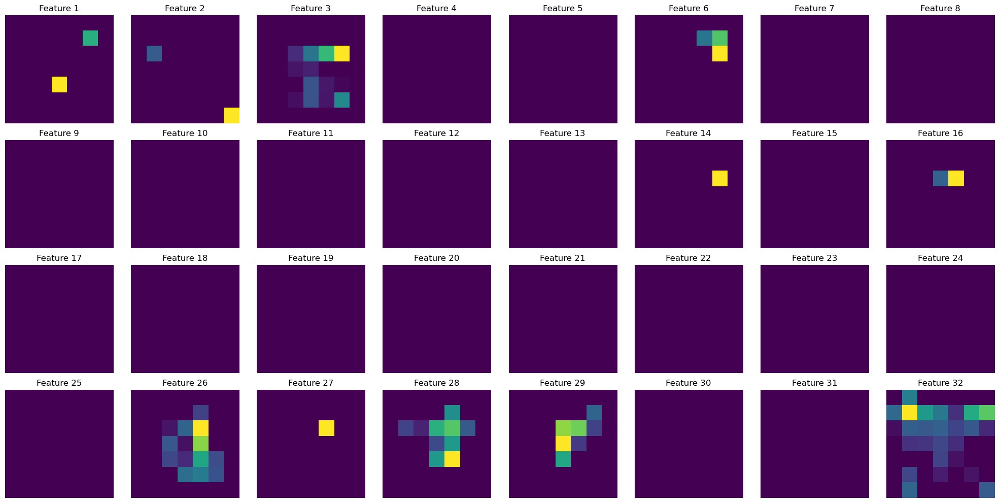

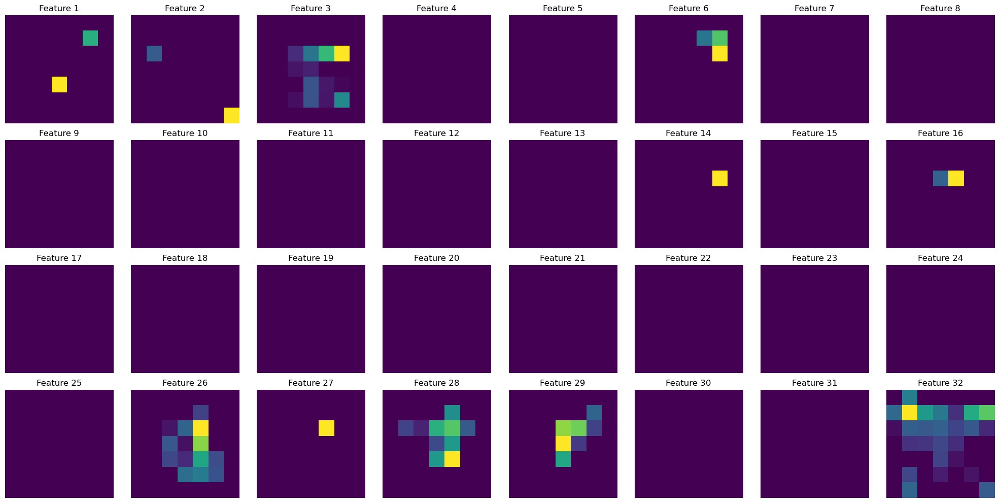

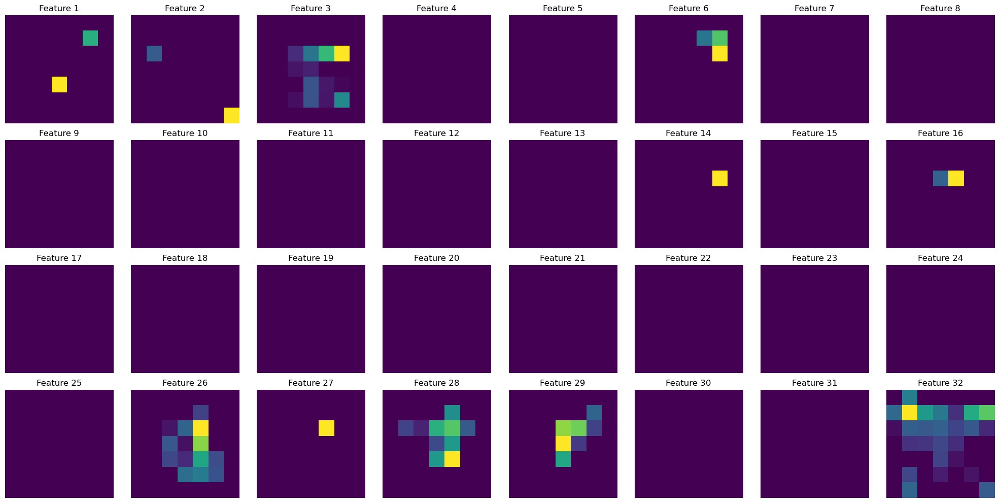

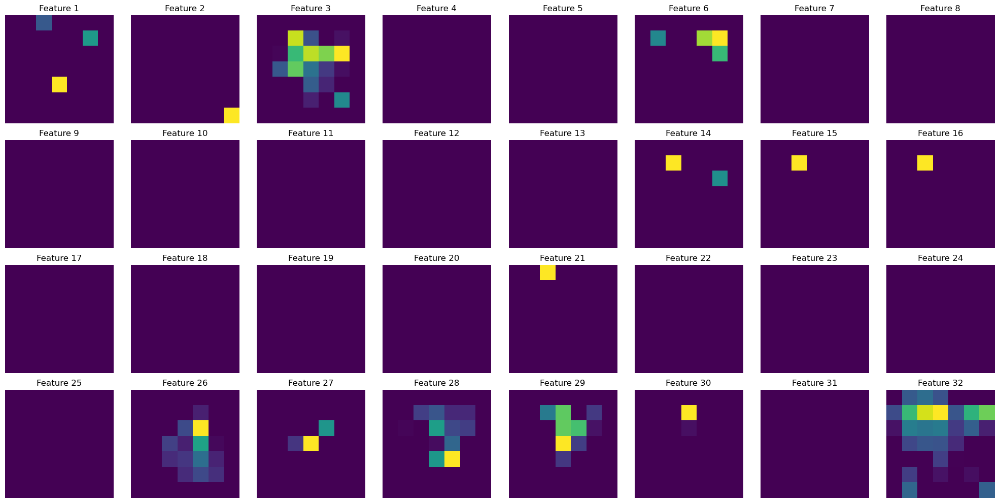

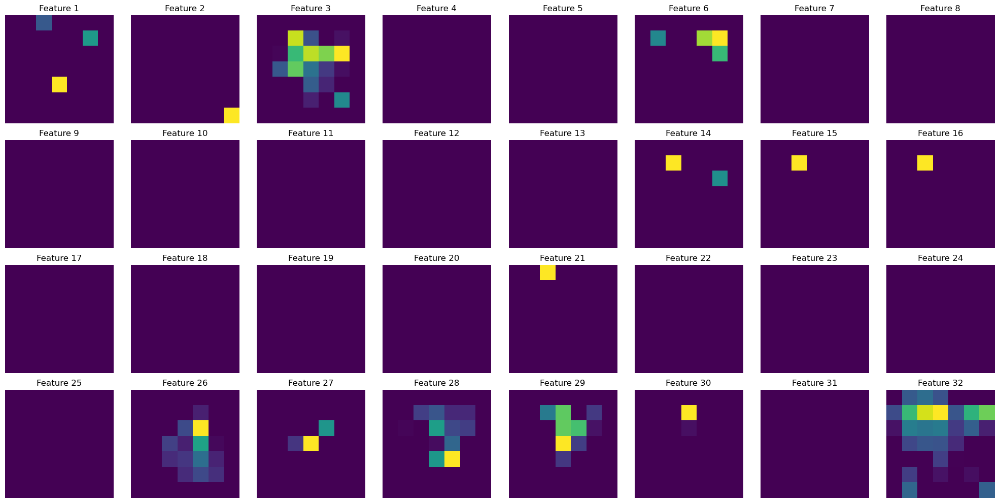

...

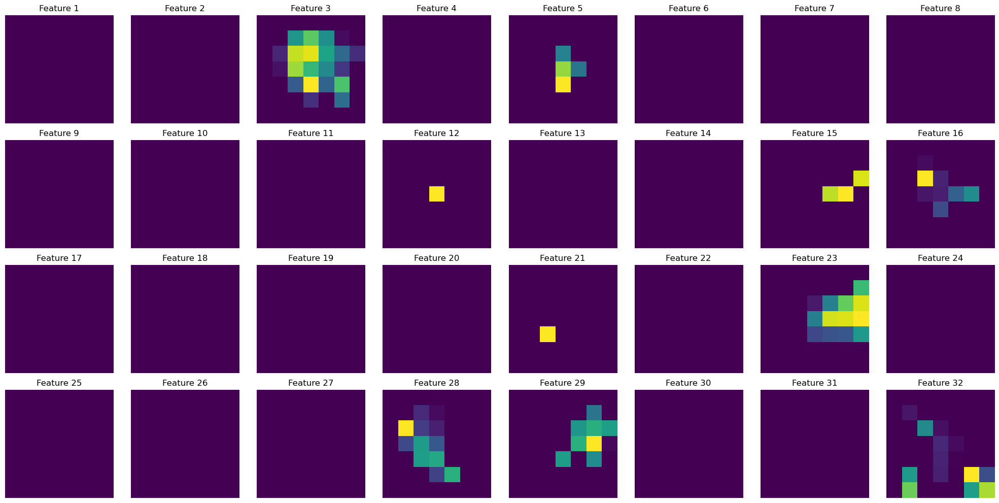

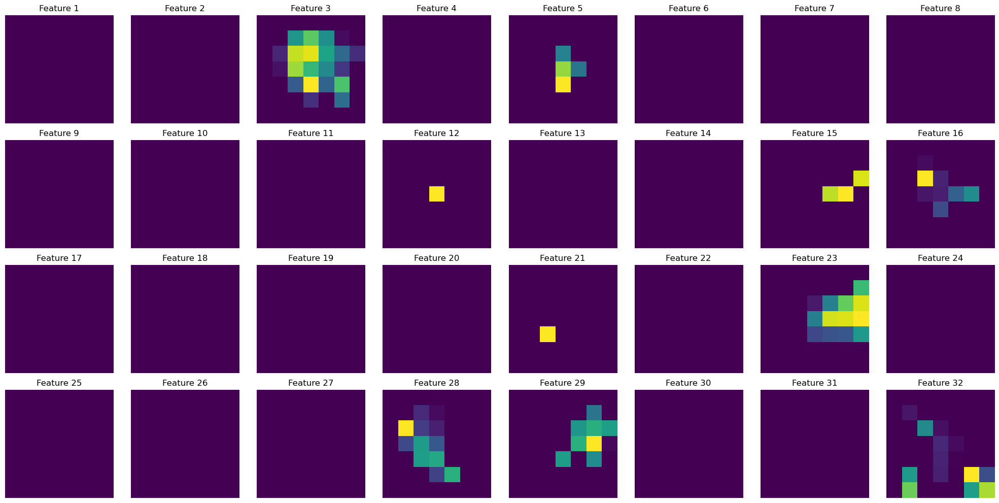

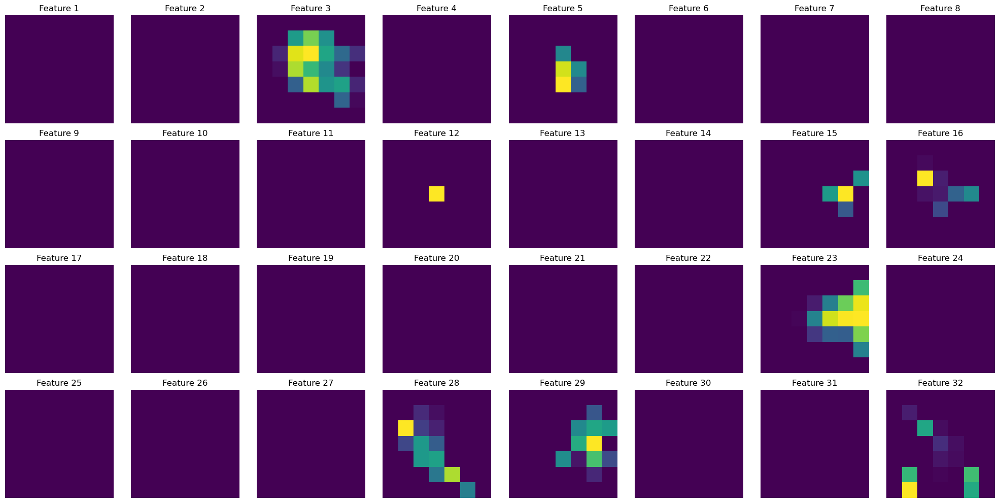

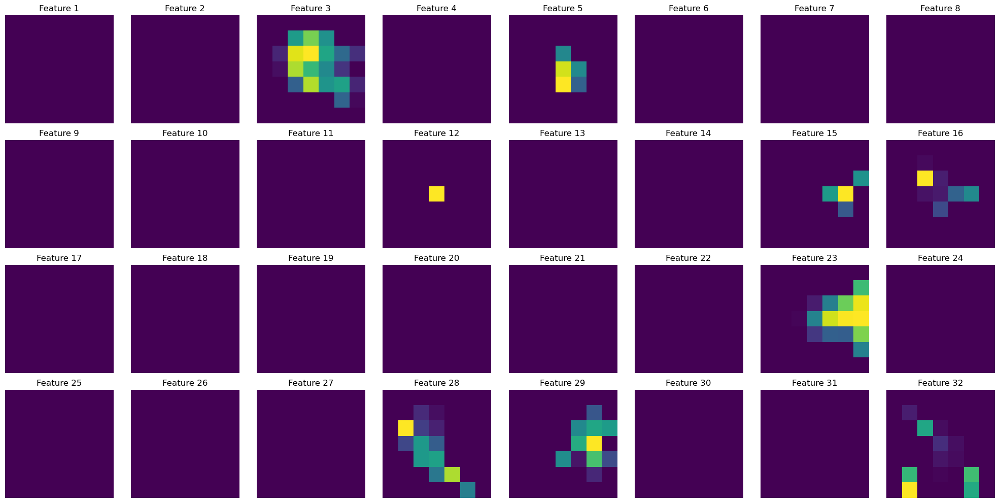

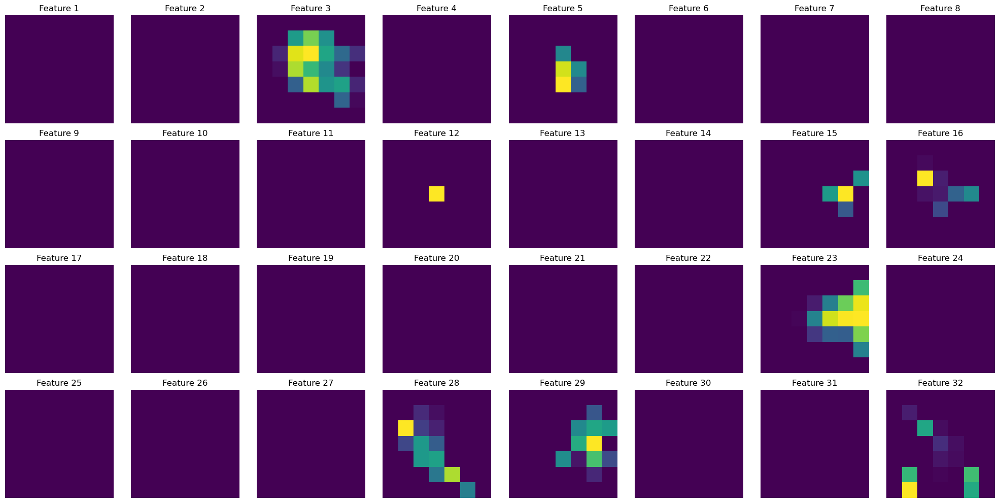

In [27]:
import torch
import torchvision.models as models
import matplotlib.pyplot as plt
import numpy as np

# Step 5: 使用预训练的 ResNet 模型提取所有增强图像的特征
model = models.resnet50(weights=models.ResNet50_Weights.DEFAULT)
model.eval()
model = torch.nn.Sequential(*list(model.children())[:-2])

all_features = []
# 定义要显示的特征图通道数
channels_to_display = 32  # 展示前32个通道的特征图
num_rows = 4
num_cols = 8

for img_tensor in augmented_images:
    with torch.no_grad():
        features = model(img_tensor)
    
    # 展示特征图
    features_np = features.squeeze().numpy()

    # 展示前几个通道的特征图
    fig, axs = plt.subplots(num_rows, num_cols, figsize=(20, 10))
    for i in range(channels_to_display):
        row = i // num_cols
        col = i % num_cols
        axs[row, col].imshow(features_np[i], cmap='viridis')
        axs[row, col].set_title(f'Feature {i+1}')
        axs[row, col].axis('off')
    
    plt.tight_layout()
    plt.show()

    # 将特征展平成一维向量
    flattened_features = features_np.reshape(features_np.shape[0], -1)
    all_features.append(flattened_features)

# 将特征数组组合在一起，形成训练集
X_train = np.vstack(all_features)

## 代码说明02：展示32个通道（一共2048个）（上图）

1. **展示32个通道**：
   - 选择展示特征图的前 32 个通道，每个通道对应不同的特征模式。

2. **4行8列布局**：
   - 使用 `fig, axs = plt.subplots(num_rows, num_cols, figsize=(20, 10))` 将图像排列成 4 行 8 列的布局，使得每个特征图都能够更清晰地展示。

3. **调整图像显示布局**：
   - 使用 `plt.tight_layout()` 自动调整子图之间的间距，确保每张特征图都清晰可见。

4. **特征展平与组合**：
   - 特征提取完成后，将特征图展平成一维向量，并将所有特征组合成训练集 `X_train`。

In [46]:
# import torch
# import torchvision.models as models
# import matplotlib.pyplot as plt
# import numpy as np

# # Step 5: 使用预训练的 ResNet 模型提取所有增强图像的特征
# model = models.resnet50(weights=models.ResNet50_Weights.DEFAULT)
# model.eval()
# model = torch.nn.Sequential(*list(model.children())[:-2])

# all_features = []
# # 定义要显示的特征图通道数
# channels_to_display = 32  # 展示前32个通道的特征图
# num_rows = 4
# num_cols = 8

# for img_tensor in augmented_images:
#     with torch.no_grad():
#         features = model(img_tensor)
    
#     # 展示特征图
#     features_np = features.squeeze().numpy()

#     # 展示前几个通道的特征图
#     fig, axs = plt.subplots(num_rows, num_cols, figsize=(20, 10))
#     for i in range(channels_to_display):
#         row = i // num_cols
#         col = i % num_cols
#         axs[row, col].imshow(features_np[i], cmap='viridis')
#         axs[row, col].set_title(f'Feature {i+1}')
#         axs[row, col].axis('off')
    
#     plt.tight_layout()
#     plt.show()

#     # 将特征展平成一维向量
#     flattened_features = features_np.reshape(features_np.shape[0], -1)
#     all_features.append(flattened_features)

#     # 可视化展平后的特征向量
#     # 将展平后的向量重塑为2D矩阵用于可视化
#     feature_matrix = flattened_features.reshape(32, -1)  # 将2048个特征重塑为32x64的矩阵
#     plt.figure(figsize=(10, 8))
#     plt.imshow(feature_matrix, cmap='viridis', aspect='auto')
#     plt.colorbar(label='Feature Intensity')
#     plt.title('Flattened Feature Vector Visualization')
#     plt.show()

# # 将特征数组组合在一起，形成训练集
# X_train = np.vstack(all_features)

## 代码说明03：每个增强图像的展平后的特征矩阵可视化结果（上图）

1. **特征展平**：
   - 提取到的 2048 个特征被展平成一维向量，准备进行后续处理。

2. **可视化展平后的特征**：
   - 将展平后的特征向量重塑为 32x64 的矩阵，并使用热图进行可视化，显示特征的强度分布。
   - 热图颜色映射使用 `viridis` 颜色映射，显示每个特征值的强度。

3. **合并特征矩阵**：
   - 所有展平后的特征被组合在一起，形成一个训练集 `X_train`。

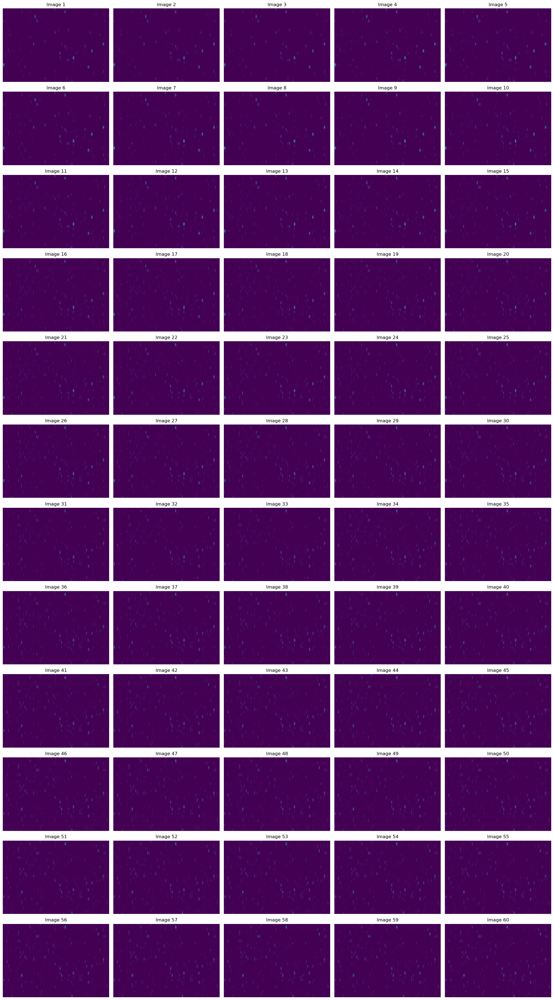

In [47]:
import matplotlib.pyplot as plt
import numpy as np

# Step 5: 展示所有展平后的特征向量可视化
num_augmented_images = len(augmented_images)
num_cols = 5  # 每行显示5张
num_rows = (num_augmented_images + num_cols - 1) // num_cols  # 计算行数

# 创建子图网格
fig, axs = plt.subplots(num_rows, num_cols, figsize=(20, num_rows * 3))

for idx, flattened_features in enumerate(all_features):
    # 将展平后的向量重塑为2D矩阵用于可视化
    feature_matrix = flattened_features.reshape(32, -1)  # 将2048个特征重塑为32x64的矩阵

    # 可视化展平后的特征向量
    row = idx // num_cols
    col = idx % num_cols
    axs[row, col].imshow(feature_matrix, cmap='viridis', aspect='auto')
    axs[row, col].set_title(f'Image {idx+1}')
    axs[row, col].axis('off')

# 隐藏未使用的子图
for i in range(idx + 1, num_rows * num_cols):
    axs[i // num_cols, i % num_cols].axis('off')

plt.tight_layout()
plt.show()

## 代码说明04：子图网格（上图）

1. **子图网格创建**：
   - 根据增强图像的数量（75 张），计算需要的行数和列数，并创建一个子图网格来显示所有的 Flattened Feature Vector Visualization。

2. **可视化所有展平的特征向量**：
   - 将每个展平后的特征向量重塑为 32x64 的矩阵，使用热图进行可视化，并在对应的子图中显示。

3. **隐藏未使用的子图**：
   - 对于可能多出的空白子图（如果列数不整除），这些子图会被隐藏。

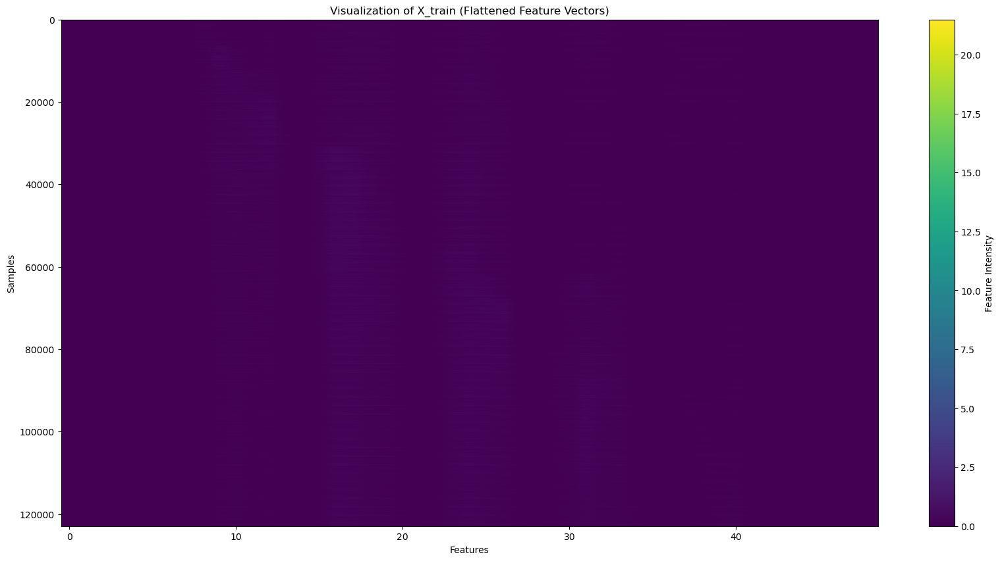

In [48]:
# 可视化训练集 X_train

import matplotlib.pyplot as plt
import numpy as np

plt.figure(figsize=(20, 10))
plt.imshow(X_train, cmap='viridis', aspect='auto')
plt.colorbar(label='Feature Intensity')
plt.title('Visualization of X_train (Flattened Feature Vectors)')
plt.xlabel('Features')
plt.ylabel('Samples')
plt.show()


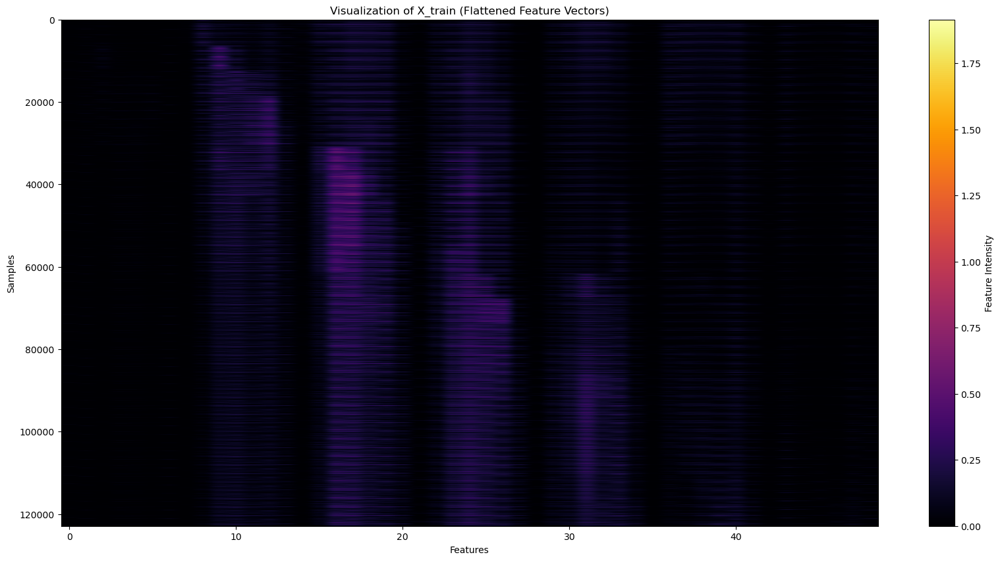

In [49]:
# 可视化训练集 X_train
# 设置更好的颜色映射，并手动调整 vmin 和 vmax

import matplotlib.pyplot as plt
import numpy as np

plt.figure(figsize=(20, 10))
plt.imshow(X_train, cmap='inferno', aspect='auto', vmin=0, vmax=np.percentile(X_train, 99))
plt.colorbar(label='Feature Intensity')
plt.title('Visualization of X_train (Flattened Feature Vectors)')
plt.xlabel('Features')
plt.ylabel('Samples')
plt.show()

## 代码说明05：step05解析

step05这段代码是整个图像处理和特征提取流程的核心部分，主要负责从经过数据增强处理的图像中提取特征，并将这些特征展平为一维向量，最终形成用于机器学习模型训练的数据集 `X_train`。

---

1. **预训练的 ResNet 模型加载与配置**：

- **加载预训练模型**：使用 `torchvision` 中的 `models.resnet50` 函数加载一个预训练的 ResNet50 模型。该模型是在 ImageNet 数据集上预训练的，因此可以提取通用的图像特征。(后续建议改为符合城市形态特征的训练结果)
   - **进入评估模式**：`model.eval()` 将模型设置为评估模式。此模式下模型的行为有所不同，例如禁用 dropout 和 batch normalization 的随机性。
   - **移除最后两层**：`model = torch.nn.Sequential(*list(model.children())[:-2])` 将 ResNet50 模型的最后两层（全连接层和全局平均池化层）移除。这样可以直接获取最后一个卷积层输出的特征图。

2. **特征提取**：

- **特征提取**：遍历所有增强后的图像 `augmented_images`，对于每个图像张量，使用预训练的 ResNet 模型提取特征。由于我们已经移除了最后的全连接层，提取的特征是最后一个卷积层输出的特征图。
   - **禁用梯度计算**：使用 `torch.no_grad()` 禁用梯度计算，因为在提取特征时不需要进行反向传播，这样可以节省内存和计算资源。
   - **特征转换**：提取到的特征图是一个多维数组（例如：`(2048, 7, 7)`），通过 `features.squeeze().numpy()` 将其转换为 NumPy 数组。然后通过 `reshape` 将特征图展平成一维向量，这一步是将 2048 个特征通道的数据展平以形成一个一维数组。
   - **保存特征**：将展平后的特征向量保存到 `all_features` 列表中。最终，`all_features` 包含了所有增强图像的展平特征，供后续机器学习模型训练使用。

3. **形成训练集**：

- **合并特征向量**：使用 `np.vstack(all_features)` 将所有图像的展平特征向量堆叠起来，形成一个二维数组 `X_train`，其中每一行对应一个图像的特征向量。`X_train` 将作为机器学习模型的输入数据。

---

总而言之，这段代码的作用是通过加载预训练的 ResNet50 模型，从增强后的图像中提取有意义的特征，并将这些特征展平成一维向量，最终形成一个可供机器学习模型使用的训练数据集 `X_train`。这个过程利用了深度学习模型强大的特征提取能力，使得后续的分类或回归模型能够基于这些高层次特征进行有效的学习和预测。

# Step 6: 训练分类模型并进行预测

In [50]:
# Step 6: 训练分类模型并进行预测
X_train = np.vstack(all_features)
y_train = np.random.randint(0, 3, X_train.shape[0])

classifier = RandomForestClassifier(n_estimators=100, random_state=42)
classifier.fit(X_train, y_train)

# 模拟测试数据并进行预测
X_test, X_valid, y_test, y_valid = train_test_split(X_train, y_train, test_size=0.2, random_state=42)
y_pred = classifier.predict(X_test)

accuracy = accuracy_score(y_test, y_pred)
print(f'Classification Accuracy: {accuracy * 100:.2f}%')

# 2024/08/14 before Classification Accuracy: 44.27% 
# 2024/0814 21:00 Classification Accuracy: 44.19%

Classification Accuracy: 44.19%


Classification Accuracy: 44.25%

Classification Report:
              precision    recall  f1-score   support

           0       0.63      0.23      0.34     32431
           1       0.38      0.86      0.53     32922
           2       0.63      0.23      0.34     32951

    accuracy                           0.44     98304
   macro avg       0.55      0.44      0.40     98304
weighted avg       0.54      0.44      0.40     98304



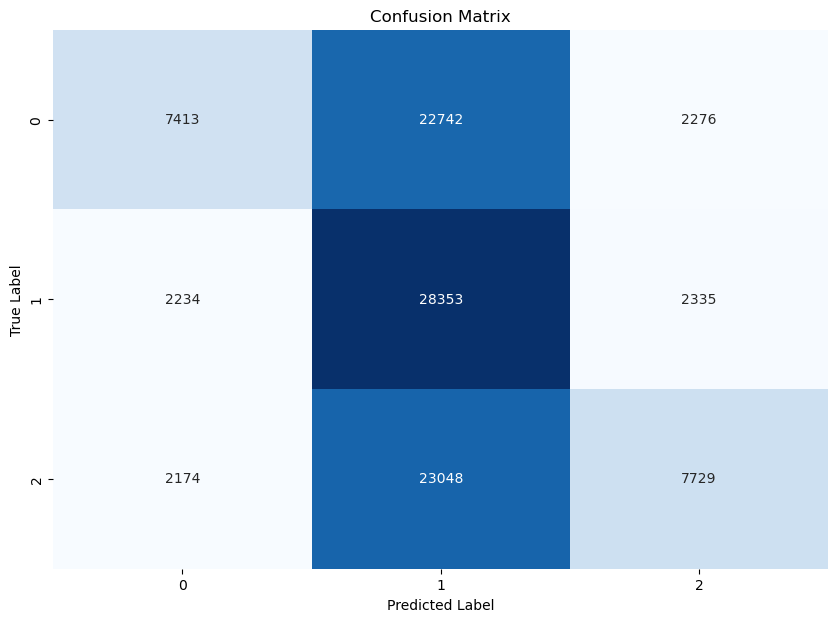

In [51]:
import numpy as np
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
import matplotlib.pyplot as plt
import seaborn as sns

# Step 6: 训练分类模型并进行预测

# 将所有提取到的特征组合在一起，形成训练集 X_train
X_train = np.vstack(all_features)

# 生成随机标签 y_train，用于模拟分类任务（实际应用中应使用真实标签）
# 这里假设我们有3个类别
y_train = np.random.randint(0, 3, X_train.shape[0])

# 初始化随机森林分类器，设定100棵决策树，并设置随机种子保证结果可重复
classifier = RandomForestClassifier(n_estimators=100, random_state=42)

# 在训练集上训练随机森林分类器
classifier.fit(X_train, y_train)

# 使用 train_test_split 将数据集划分为训练集（80%）和测试集（20%）
X_test, X_valid, y_test, y_valid = train_test_split(X_train, y_train, test_size=0.2, random_state=42)

# 使用训练好的模型对测试集进行预测
y_pred = classifier.predict(X_test)

# 计算分类准确率，并输出结果
accuracy = accuracy_score(y_test, y_pred)
print(f'Classification Accuracy: {accuracy * 100:.2f}%')

# 输出分类报告，包括精度（precision）、召回率（recall）、F1分数等
print("\nClassification Report:")
print(classification_report(y_test, y_pred))

# 计算混淆矩阵，用于可视化分类模型的性能
conf_matrix = confusion_matrix(y_test, y_pred)

# 可视化混淆矩阵
plt.figure(figsize=(10, 7))
sns.heatmap(conf_matrix, annot=True, fmt="d", cmap="Blues", cbar=False)
plt.title("Confusion Matrix")
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.show()

## 代码说明01


1. **X_train 的形成**：
   - `X_train = np.vstack(all_features)`：将所有增强后的图像特征（从 `Step 5` 中提取的）堆叠在一起，形成最终的训练集 `X_train`。

2. **生成随机标签**：
   - `y_train = np.random.randint(0, 3, X_train.shape[0])`：生成随机的训练标签，用于模拟分类任务。假设有 3 个类别（0、1、2）。
   - 注意！！！**本步骤的标签为随机生成的，类别和数量均不具有参考价值**。

3. **训练随机森林分类器**：
   - `classifier = RandomForestClassifier(n_estimators=100, random_state=42)`：初始化一个随机森林分类器，设置 100 棵决策树。
   - `classifier.fit(X_train, y_train)`：在 `X_train` 上训练分类器。

4. **划分训练集和测试集**：
   - `X_test, X_valid, y_test, y_valid = train_test_split(X_train, y_train, test_size=0.2, random_state=42)`：将数据划分为训练集和测试集，其中 20% 的数据用于测试。

5. **进行预测**：
   - `y_pred = classifier.predict(X_test)`：使用训练好的模型对测试集进行预测，并将结果存储在 `y_pred` 中。

6. **计算并输出分类准确率**：
   - `accuracy = accuracy_score(y_test, y_pred)`：计算模型在测试集上的准确率，并输出结果。

7. **输出分类报告**：
   - `classification_report(y_test, y_pred)`：输出分类模型的详细报告，包括精度（precision）、召回率（recall）和 F1 分数。

8. **混淆矩阵可视化**：
   - `conf_matrix = confusion_matrix(y_test, y_pred)`：计算混淆矩阵，展示模型在各个类别上的预测准确性。
   - 使用 Seaborn 绘制热图，展示混淆矩阵的结果，以便直观地了解模型的预测表现。

## 代码改进01：使用 DBSCAN 自动生成类别

In [52]:
# # 使用 DBSCAN 自动生成类别
# from sklearn.cluster import DBSCAN
# from sklearn.ensemble import RandomForestClassifier
# from sklearn.model_selection import train_test_split
# from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
# import matplotlib.pyplot as plt
# import seaborn as sns
# import numpy as np

In [1]:
# # 使用DBSCAN进行聚类，eps是两个样本被视为邻居的最大距离，min_samples是一个簇中所需的最小样本数
# dbscan = DBSCAN(eps=0.5, min_samples=5)
# y_train = dbscan.fit_predict(X_train)

In [2]:
# # DBSCAN中的标签值为-1的表示噪声点（不属于任何簇），我们需要排除这些点进行后续的训练
# mask = y_train != -1  # 选择非噪声点
# X_train_filtered = X_train[mask]
# y_train_filtered = y_train[mask]

In [3]:
# # 使用随机森林分类器进行监督学习
# classifier = RandomForestClassifier(n_estimators=100, random_state=42)
# classifier.fit(X_train_filtered, y_train_filtered)

# # 划分训练集和测试集
# X_train_split, X_test_split, y_train_split, y_test_split = train_test_split(X_train_filtered, y_train_filtered, test_size=0.2, random_state=42)

# # 对测试集进行预测
# y_pred = classifier.predict(X_test_split)

# # 计算分类准确率
# accuracy = accuracy_score(y_test_split, y_pred)
# print(f'Classification Accuracy: {accuracy * 100:.2f}%')

In [4]:
# # 输出分类报告
# print("\nClassification Report:")
# print(classification_report(y_test_split, y_pred))

# # 混淆矩阵可视化
# conf_matrix = confusion_matrix(y_test_split, y_pred)
# plt.figure(figsize=(10, 7))
# sns.heatmap(conf_matrix, annot=True, fmt="d", cmap="Blues", cbar=False)
# plt.title("Confusion Matrix")
# plt.xlabel("Predicted Label")
# plt.ylabel("True Label")
# plt.show()

In [53]:
import numpy as np
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
import matplotlib.pyplot as plt
import seaborn as sns

In [54]:
# Step 6: 训练分类模型并进行预测

# 将所有提取到的特征组合在一起，形成训练集 X_train
X_train = np.vstack(all_features)
# 将提取的所有特征整合为一个二维数组（矩阵），每一行对应一个样本的特征向量。

In [55]:
# 生成随机标签 y_train，用于模拟分类任务（实际应用中应使用真实标签）
# 这里假设我们有3个类别
y_train = np.random.randint(0, 3, X_train.shape[0])
# 生成一个随机标签数组 y_train，其中的值为 0、1 或 2，代表 3 个不同的类别。
# 这一步是为了模拟分类任务，实际使用时应当使用真实的标签数据。

In [56]:
# 初始化随机森林分类器，设定100棵决策树，并设置随机种子保证结果可重复
classifier = RandomForestClassifier(n_estimators=100, random_state=42)
# 创建一个随机森林分类器实例，设置为使用 100 棵决策树。随机种子 random_state=42 是为了保证每次运行结果一致。

In [57]:
# 在训练集上训练随机森林分类器
classifier.fit(X_train, y_train)
# 使用生成的特征数据 X_train 和模拟的标签 y_train 训练随机森林分类器。分类器学习如何根据输入特征预测类别。

# 使用 train_test_split 将数据集划分为训练集（80%）和测试集（20%）
X_test, X_valid, y_test, y_valid = train_test_split(X_train, y_train, test_size=0.2, random_state=42)
# 将训练好的数据集再次划分为训练集和测试集，测试集占 20%。这一步是为了评估模型在未见过的数据上的性能。

# 使用训练好的模型对测试集进行预测
y_pred = classifier.predict(X_test)
# 使用训练好的随机森林分类器对测试集 X_test 进行预测，生成预测的标签 y_pred。

# 计算分类准确率，并输出结果
accuracy = accuracy_score(y_test, y_pred)
print(f'Classification Accuracy: {accuracy * 100:.2f}%')
# 计算预测结果的分类准确率，表示模型在测试集上的性能。

# 输出分类报告，包括精度（precision）、召回率（recall）、F1分数等
print("\nClassification Report:")
print(classification_report(y_test, y_pred))
# 输出分类报告，详细说明分类器在各个类别上的表现，包括精度、召回率和 F1 分数。

# 计算混淆矩阵，用于可视化分类模型的性能
conf_matrix = confusion_matrix(y_test, y_pred)
# 计算混淆矩阵，展示模型在每个类别上的正确预测和错误预测情况。

Classification Accuracy: 44.32%

Classification Report:
              precision    recall  f1-score   support

           0       0.38      0.87      0.53     32998
           1       0.63      0.23      0.34     32468
           2       0.62      0.23      0.34     32838

    accuracy                           0.44     98304
   macro avg       0.55      0.44      0.40     98304
weighted avg       0.55      0.44      0.40     98304



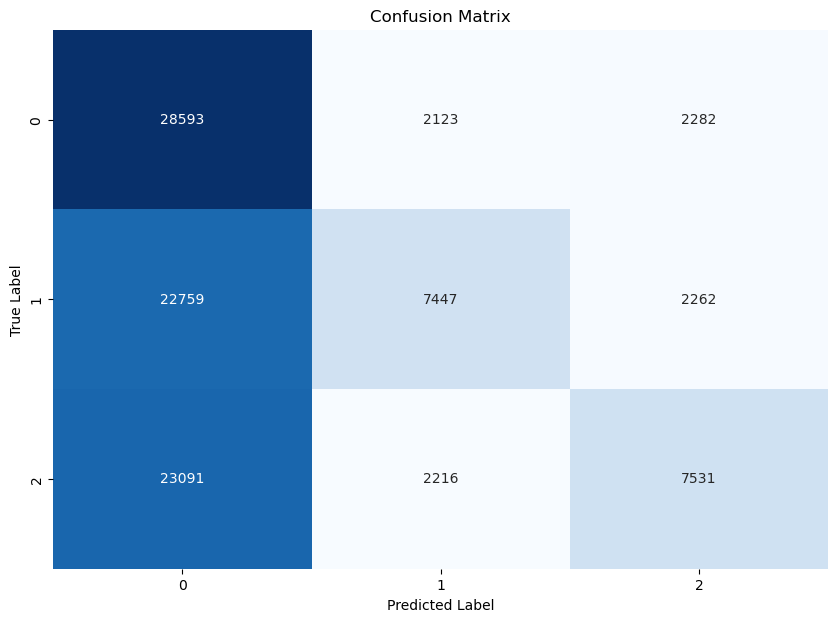

In [60]:
# 可视化混淆矩阵
plt.figure(figsize=(10, 7))
sns.heatmap(conf_matrix, annot=True, fmt="d", cmap="Blues", cbar=False)
plt.title("Confusion Matrix")
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.show()
# 使用 Seaborn 的 heatmap 函数可视化混淆矩阵，展示分类器在各个类别上的表现。热图中颜色越深表示预测越准确。

## 预期结果

1. 分类模型的准确性：

- 分类准确率：显示模型在测试集上的分类准确率。一个高准确率表明模型能够很好地识别和区分不同的城市区域类别。
- 分类报告：包括每个类别的精度（precision）、召回率（recall）和 F1 分数，这些指标帮助您理解模型在不同类别上的表现，尤其是模型是否有偏向某些类别。

2. 混淆矩阵：

- 混淆矩阵提供了一个可视化工具，显示模型在不同类别上的预测结果。它能够帮助识别哪些类别易于混淆，以及模型在哪些类别上的表现欠佳。

# Step 7: 展示分类结果

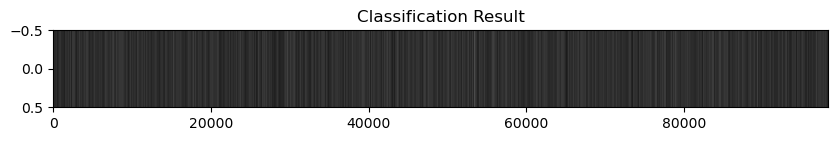

In [59]:
# Step 7: 展示分类结果
plt.figure(figsize=(10, 1))
plt.imshow(y_pred.reshape(1, -1), cmap='gray', aspect='auto')
plt.title('Classification Result')
plt.show()

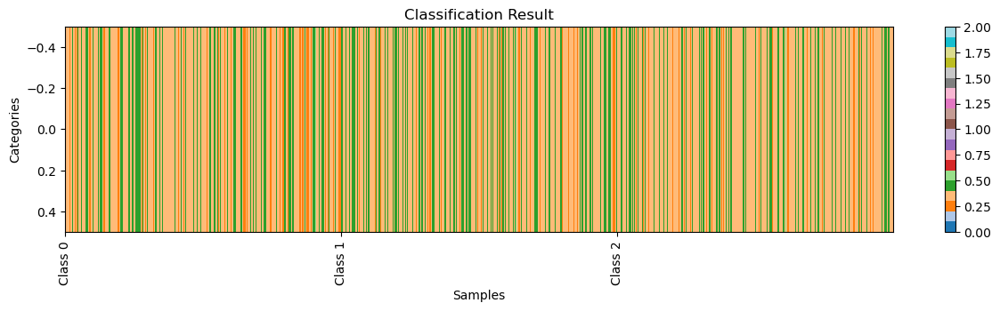

In [61]:
# Step 7: 展示分类结果

# 改进的分类结果可视化
plt.figure(figsize=(15, 3))  # 调整图像尺寸，增加高度以提升可读性

# 使用多种颜色表示不同类别
plt.imshow(y_pred.reshape(1, -1), cmap='tab20', aspect='auto')

# 增加类别标注
num_classes = len(np.unique(y_pred))
class_labels = [f"Class {i}" for i in range(num_classes)]
plt.xticks(ticks=np.arange(0, len(y_pred), step=len(y_pred) // num_classes),
           labels=class_labels, rotation=90)

# 添加图像标题
plt.title('Classification Result')
plt.xlabel('Samples')
plt.ylabel('Categories')
plt.colorbar()  # 添加颜色条，方便识别各类别颜色

plt.show()

### 代码的详细解释

1. **分类模型训练与预测**：
   - 代码首先将提取到的特征数据整合为一个训练集 `X_train`，并生成随机标签 `y_train` 作为分类目标（在实际应用中应使用真实的标签）。
   - 随后，使用随机森林模型对数据进行训练，并在测试集上进行预测，输出分类准确率、分类报告和混淆矩阵。

2. **混淆矩阵可视化**：
   - 混淆矩阵展示了模型在不同类别上的预测性能，包括正确分类和错误分类的情况。
   - 通过混淆矩阵，可以直观地看到哪些类别容易被混淆，为后续模型的优化提供参考。

3. **分类结果的改进可视化**：
   - 使用彩色映射 `tab20` 展示预测的分类结果，不同类别的样本以不同的颜色表示。
   - 在图像上方添加类别标注，使得每个类别对应的颜色更加清晰。
   - 通过颜色条 `colorbar`，提供颜色和类别之间的对照，便于快速理解图像中的分类结果。

### 预期输出

- **分类准确率**：显示模型在测试集上的整体表现。
- **分类报告**：提供关于每个类别的精度、召回率和 F1 分数的详细信息。
- **混淆矩阵**：图形化展示模型在每个类别上的正确预测和错误预测情况。
- **分类结果可视化**：彩色的分类结果图像，使得每个样本的分类类别直观可见，并提供清晰的类别标注和对照。


<Figure size 1000x1000 with 0 Axes>

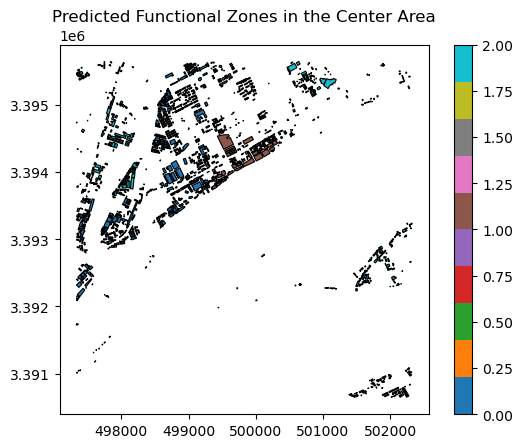

In [63]:
# 将 y_pred 中的预测结果映射回到对应的子区域
# 这部分假设 y_pred 的顺序与 segmented_images 中的子区域顺序一致
center_area['predicted_class'] = np.nan  # 初始化一个列来存储预测类别

# 将预测结果对应到每个区域（假设区域顺序一致）
for i, (region_name, (x_min_r, x_max_r, y_min_r, y_max_r)) in enumerate(regions):
    mask = (
        (center_area.geometry.bounds.minx >= x_min_r) &
        (center_area.geometry.bounds.maxx <= x_max_r) &
        (center_area.geometry.bounds.miny >= y_min_r) &
        (center_area.geometry.bounds.maxy <= y_max_r)
    )
    center_area.loc[mask, 'predicted_class'] = y_pred[i]

# 可视化不同类别的建筑分布
plt.figure(figsize=(10, 10))
center_area.plot(column='predicted_class', cmap='tab10', legend=True, linewidth=0.8, edgecolor='black')
plt.title('Predicted Functional Zones in the Center Area')
plt.show()


C:\Users\asus\AppData\Roaming\Python\Python311\site-packages\geopandas\geodataframe.py:1819: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)


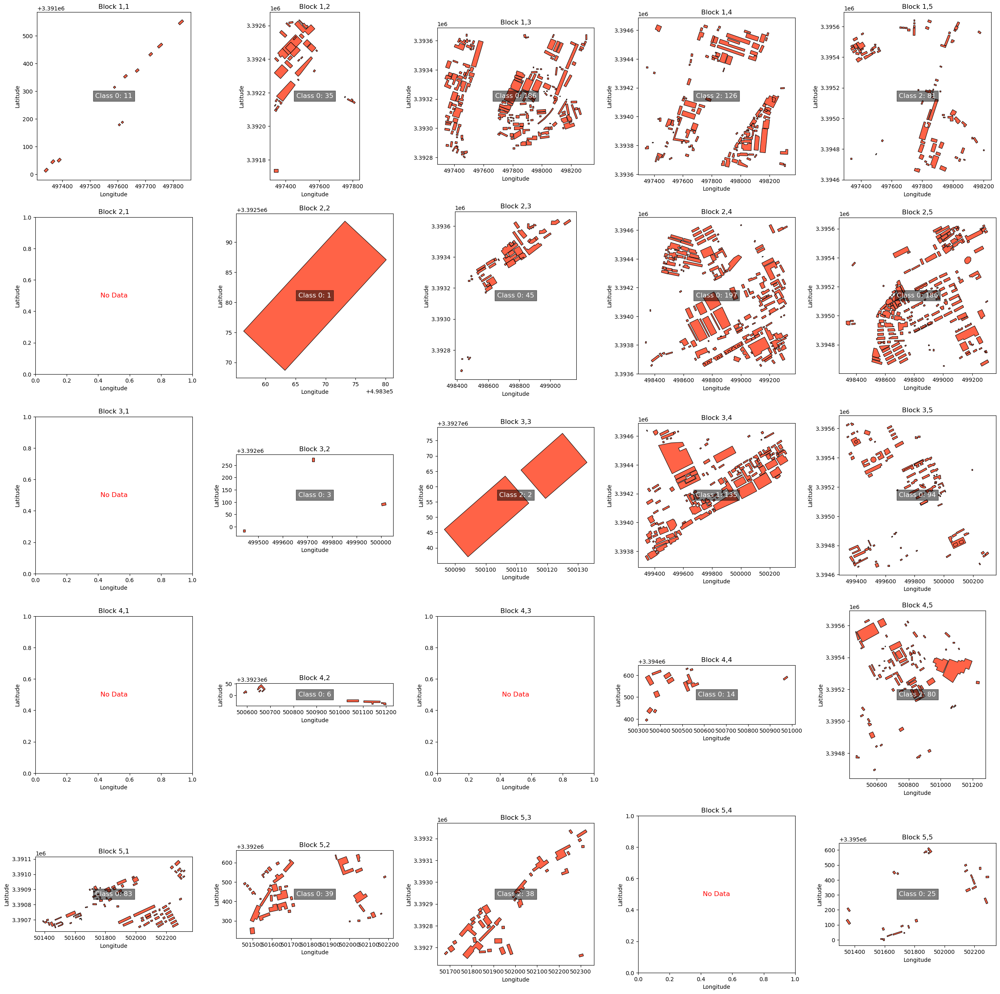

In [64]:
# 进行地区的放大展示，由5×5的正方形组成，每个部分还要展示出包含了哪些类别的地块，并标注在图上。

import matplotlib.pyplot as plt
import geopandas as gpd
import numpy as np
from matplotlib.colors import ListedColormap

# 假设已经有 y_pred 分类结果，并且 regions 包含了区域名称和边界信息

# 将分类结果映射回对应的区域
center_area['predicted_class'] = np.nan  # 初始化一个列来存储预测类别

for i, (region_name, (x_min_r, x_max_r, y_min_r, y_max_r)) in enumerate(regions):
    mask = (
        (center_area.geometry.bounds.minx >= x_min_r) &
        (center_area.geometry.bounds.maxx <= x_max_r) &
        (center_area.geometry.bounds.miny >= y_min_r) &
        (center_area.geometry.bounds.maxy <= y_max_r)
    )
    center_area.loc[mask, 'predicted_class'] = y_pred[i]

# 设置图像的大小和网格
fig, axs = plt.subplots(5, 5, figsize=(25, 25))
axs = axs.flatten()

# 使用一个自定义的颜色映射
cmap = ListedColormap(['#FF6347', '#4682B4', '#3CB371'])  # 例如红、蓝、绿代表不同的类别

for i, (region_name, (x_min_r, x_max_r, y_min_r, y_max_r)) in enumerate(regions):
    region_ax = axs[i]
    region_area = center_area.cx[x_min_r:x_max_r, y_min_r:y_max_r]

    if not region_area.empty:
        region_area.plot(column='predicted_class', ax=region_ax, cmap=cmap, legend=False, linewidth=0.8, edgecolor='black')
        
        # 统计类别并标注在图上
        unique_classes = region_area['predicted_class'].dropna().unique()
        class_counts = region_area['predicted_class'].value_counts().to_dict()
        
        # 在图像中显示每个类别及其数量
        text_str = '\n'.join([f'Class {int(cls)}: {count}' for cls, count in class_counts.items()])
        region_ax.text(0.5, 0.5, text_str, transform=region_ax.transAxes, ha='center', va='center', fontsize=12, color='white', bbox=dict(facecolor='black', alpha=0.5))
    else:
        region_ax.text(0.5, 0.5, 'No Data', ha='center', va='center', fontsize=12, color='red')

    region_ax.set_aspect('equal')
    region_ax.set_xlabel("Longitude")
    region_ax.set_ylabel("Latitude")
    region_ax.set_title(f"{region_name}")

plt.tight_layout()
plt.show()


In [70]:
# import matplotlib.pyplot as plt
# import geopandas as gpd
# import numpy as np
# from matplotlib.colors import ListedColormap

# # 假设已经有 y_pred 分类结果，并且 regions 包含了区域名称和边界信息

# # 将分类结果映射回对应的区域
# center_area['predicted_class'] = np.nan  # 初始化一个列来存储预测类别

# for i, (region_name, (x_min_r, x_max_r, y_min_r, y_max_r)) in enumerate(regions):
#     mask = (
#         (center_area.geometry.bounds.minx >= x_min_r) &
#         (center_area.geometry.bounds.maxx <= x_max_r) &
#         (center_area.geometry.bounds.miny >= y_min_r) &
#         (center_area.geometry.bounds.maxy <= y_max_r)
#     )
#     center_area.loc[mask, 'predicted_class'] = y_pred[i]

# # 设置图像的大小和网格
# fig, axs = plt.subplots(5, 5, figsize=(25, 25))
# axs = axs.flatten()

# # 使用一个自定义的颜色映射，不同的颜色代表不同的类别
# cmap = ListedColormap(['#FF6347', '#4682B4', '#3CB371'])  # 例如红、蓝、绿代表不同的类别

# for i, (region_name, (x_min_r, x_max_r, y_min_r, y_max_r)) in enumerate(regions):
#     region_ax = axs[i]
#     region_area = center_area.cx[x_min_r:x_max_r, y_min_r:y_max_r]

#     if not region_area.empty:
#         region_area.plot(column='predicted_class', ax=region_ax, cmap=cmap, legend=False, linewidth=0.8, edgecolor='black')
        
#         # 统计类别并准备标注内容
#         unique_classes = region_area['predicted_class'].dropna().unique()
#         class_counts = region_area['predicted_class'].value_counts().to_dict()
        
#         # 准备显示在下方的标注内容
#         text_str = '\n'.join([f'Class {int(cls)}: {count}' for cls, count in class_counts.items()])
#         region_ax.set_title(f"{region_name}\n{text_str}", fontsize=10, loc='center', pad=20)
#     else:
#         region_ax.text(0.5, 0.5, 'No Data', ha='center', va='center', fontsize=12, color='red')

#     region_ax.set_aspect('equal')
#     region_ax.set_xlabel("Longitude")
#     region_ax.set_ylabel("Latitude")

# plt.tight_layout()
# plt.show()

In [71]:
# import matplotlib.pyplot as plt
# import geopandas as gpd
# import numpy as np
# from matplotlib.colors import ListedColormap

# # 假设已经有 y_pred 分类结果，并且 regions 包含了区域名称和边界信息

# # 将分类结果映射回对应的区域
# center_area['predicted_class'] = np.nan  # 初始化一个列来存储预测类别

# for i, (region_name, (x_min_r, x_max_r, y_min_r, y_max_r)) in enumerate(regions):
#     mask = (
#         (center_area.geometry.bounds.minx >= x_min_r) &
#         (center_area.geometry.bounds.maxx <= x_max_r) &
#         (center_area.geometry.bounds.miny >= y_min_r) &
#         (center_area.geometry.bounds.maxy <= y_max_r)
#     )
#     center_area.loc[mask, 'predicted_class'] = y_pred[i]

# # 设置图像的大小和网格
# fig, axs = plt.subplots(5, 5, figsize=(25, 25))
# axs = axs.flatten()

# # 使用一个自定义的颜色映射，不同的颜色代表不同的类别
# cmap = ListedColormap(['#FF6347', '#4682B4', '#3CB371'])  # 例如红、蓝、绿代表不同的类别

# for i, (region_name, (x_min_r, x_max_r, y_min_r, y_max_r)) in enumerate(regions):
#     region_ax = axs[i]
#     region_area = center_area.cx[x_min_r:x_max_r, y_min_r:y_max_r]

#     if not region_area.empty:
#         # 将地块按类别颜色显示
#         region_area.plot(column='predicted_class', ax=region_ax, cmap=cmap, legend=False, linewidth=0.8, edgecolor='black')
        
#         # 统计类别并准备标注内容
#         unique_classes = region_area['predicted_class'].dropna().unique()
#         class_counts = region_area['predicted_class'].value_counts().to_dict()
        
#         # 准备显示在下方的标注内容
#         text_str = '\n'.join([f'Class {int(cls)}: {count}' for cls, count in class_counts.items()])
#         region_ax.set_title(f"{region_name}\n{text_str}", fontsize=10, loc='center', pad=20)
#     else:
#         region_ax.text(0.5, 0.5, 'No Data', ha='center', va='center', fontsize=12, color='red')

#     region_ax.set_aspect('equal')
#     region_ax.set_xlabel("Longitude")
#     region_ax.set_ylabel("Latitude")

# plt.tight_layout()
# plt.show()


In [72]:
# import matplotlib.pyplot as plt
# import geopandas as gpd
# import numpy as np
# from matplotlib.colors import ListedColormap

# # 假设已经有 y_pred 分类结果，并且 regions 包含了区域名称和边界信息

# # 将分类结果映射回对应的区域
# center_area['predicted_class'] = np.nan  # 初始化一个列来存储预测类别

# for i, (region_name, (x_min_r, x_max_r, y_min_r, y_max_r)) in enumerate(regions):
#     mask = (
#         (center_area.geometry.bounds.minx >= x_min_r) &
#         (center_area.geometry.bounds.maxx <= x_max_r) &
#         (center_area.geometry.bounds.miny >= y_min_r) &
#         (center_area.geometry.bounds.maxy <= y_max_r)
#     )
#     center_area.loc[mask, 'predicted_class'] = y_pred[i]

# # 设置图像的大小和网格
# fig, axs = plt.subplots(5, 5, figsize=(25, 25))
# axs = axs.flatten()

# # 使用一个自定义的颜色映射，不同的颜色代表不同的类别
# cmap_dict = {
#     0: '#FF6347',  # Tomato for Class 0
#     1: '#4682B4',  # SteelBlue for Class 1
#     2: '#3CB371'   # MediumSeaGreen for Class 2
# }

# for i, (region_name, (x_min_r, x_max_r, y_min_r, y_max_r)) in enumerate(regions):
#     region_ax = axs[i]
#     region_area = center_area.cx[x_min_r:x_max_r, y_min_r:y_max_r]

#     if not region_area.empty:
#         # 确定这个区域的主要分类类别
#         majority_class = y_pred[i]
#         color = cmap_dict.get(majority_class, '#D3D3D3')  # 默认为浅灰色

#         # 为这个区域内的所有地块应用相同的颜色
#         region_area.plot(ax=region_ax, color=color, linewidth=0.8, edgecolor='black')
        
#         # 统计类别并准备标注内容
#         class_counts = region_area['predicted_class'].value_counts().to_dict()
        
#         # 准备显示在下方的标注内容
#         text_str = f"Class {majority_class}: {class_counts.get(majority_class, 0)}"
#         region_ax.set_title(f"{region_name}\n{text_str}", fontsize=10, loc='center', pad=20)
#     else:
#         region_ax.text(0.5, 0.5, 'No Data', ha='center', va='center', fontsize=12, color='red')

#     region_ax.set_aspect('equal')
#     region_ax.set_xlabel("Longitude")
#     region_ax.set_ylabel("Latitude")

# plt.tight_layout()
# plt.show()


C:\Users\asus\AppData\Roaming\Python\Python311\site-packages\geopandas\geodataframe.py:1819: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)


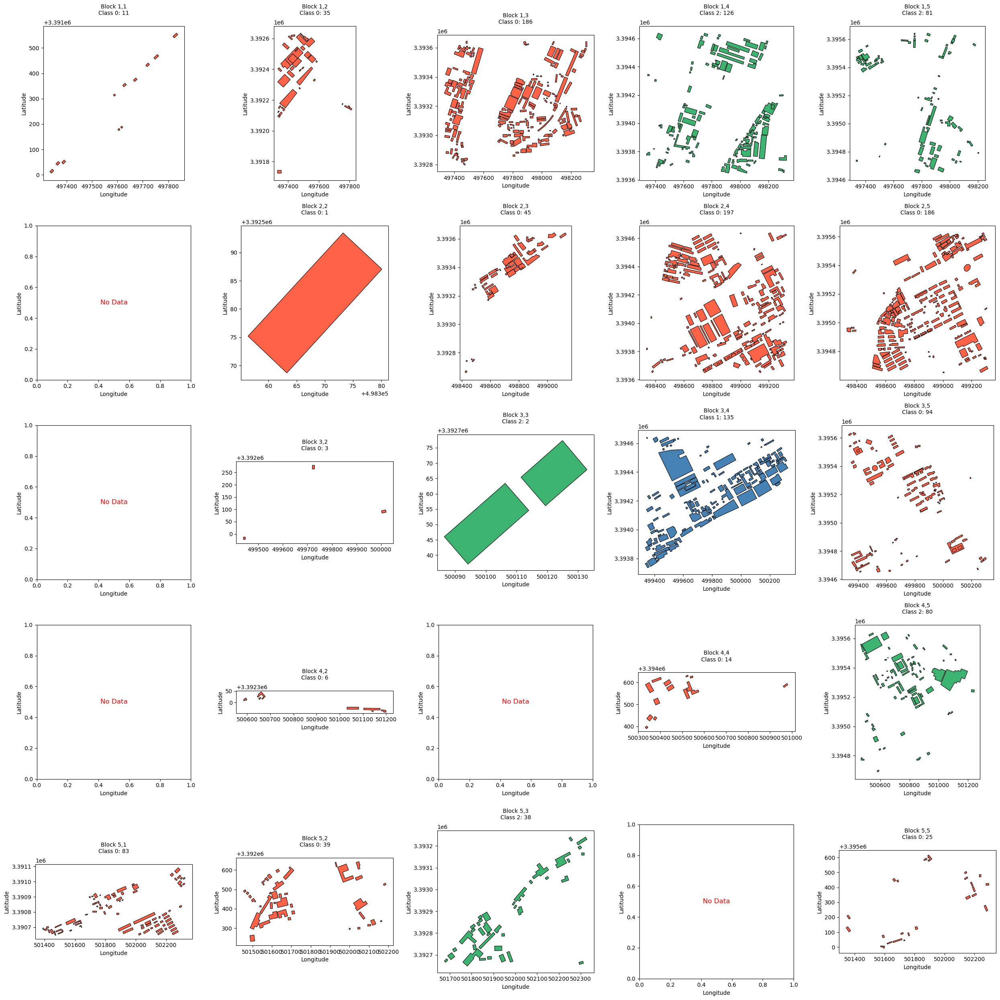

In [73]:
import matplotlib.pyplot as plt
import geopandas as gpd
import numpy as np
from matplotlib.colors import ListedColormap

# 假设已经有 y_pred 分类结果，并且 regions 包含了区域名称和边界信息

# 将分类结果映射回对应的区域
center_area['predicted_class'] = np.nan  # 初始化一个列来存储预测类别

for i, (region_name, (x_min_r, x_max_r, y_min_r, y_max_r)) in enumerate(regions):
    mask = (
        (center_area.geometry.bounds.minx >= x_min_r) &
        (center_area.geometry.bounds.maxx <= x_max_r) &
        (center_area.geometry.bounds.miny >= y_min_r) &
        (center_area.geometry.bounds.maxy <= y_max_r)
    )
    center_area.loc[mask, 'predicted_class'] = y_pred[i]

# 设置图像的大小和网格
fig, axs = plt.subplots(5, 5, figsize=(25, 25))
axs = axs.flatten()

# 使用一个自定义的颜色映射，不同的颜色代表不同的类别
cmap_dict = {
    0: '#FF6347',  # Tomato for Class 0
    1: '#4682B4',  # SteelBlue for Class 1
    2: '#3CB371'   # MediumSeaGreen for Class 2
}

for i, (region_name, (x_min_r, x_max_r, y_min_r, y_max_r)) in enumerate(regions):
    region_ax = axs[i]
    region_area = center_area.cx[x_min_r:x_max_r, y_min_r:y_max_r]

    if not region_area.empty:
        # 根据每个建筑物的类别设置颜色
        for cls in cmap_dict.keys():
            class_area = region_area[region_area['predicted_class'] == cls]
            if not class_area.empty:
                class_area.plot(ax=region_ax, color=cmap_dict[cls], linewidth=0.8, edgecolor='black')
        
        # 统计类别并准备标注内容
        class_counts = region_area['predicted_class'].value_counts().to_dict()
        
        # 准备显示在下方的标注内容
        text_str = '\n'.join([f'Class {int(cls)}: {count}' for cls, count in class_counts.items()])
        region_ax.set_title(f"{region_name}\n{text_str}", fontsize=10, loc='center', pad=20)
    else:
        region_ax.text(0.5, 0.5, 'No Data', ha='center', va='center', fontsize=12, color='red')

    region_ax.set_aspect('equal')
    region_ax.set_xlabel("Longitude")
    region_ax.set_ylabel("Latitude")

plt.tight_layout()
plt.show()


C:\Users\asus\AppData\Roaming\Python\Python311\site-packages\geopandas\geodataframe.py:1819: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)


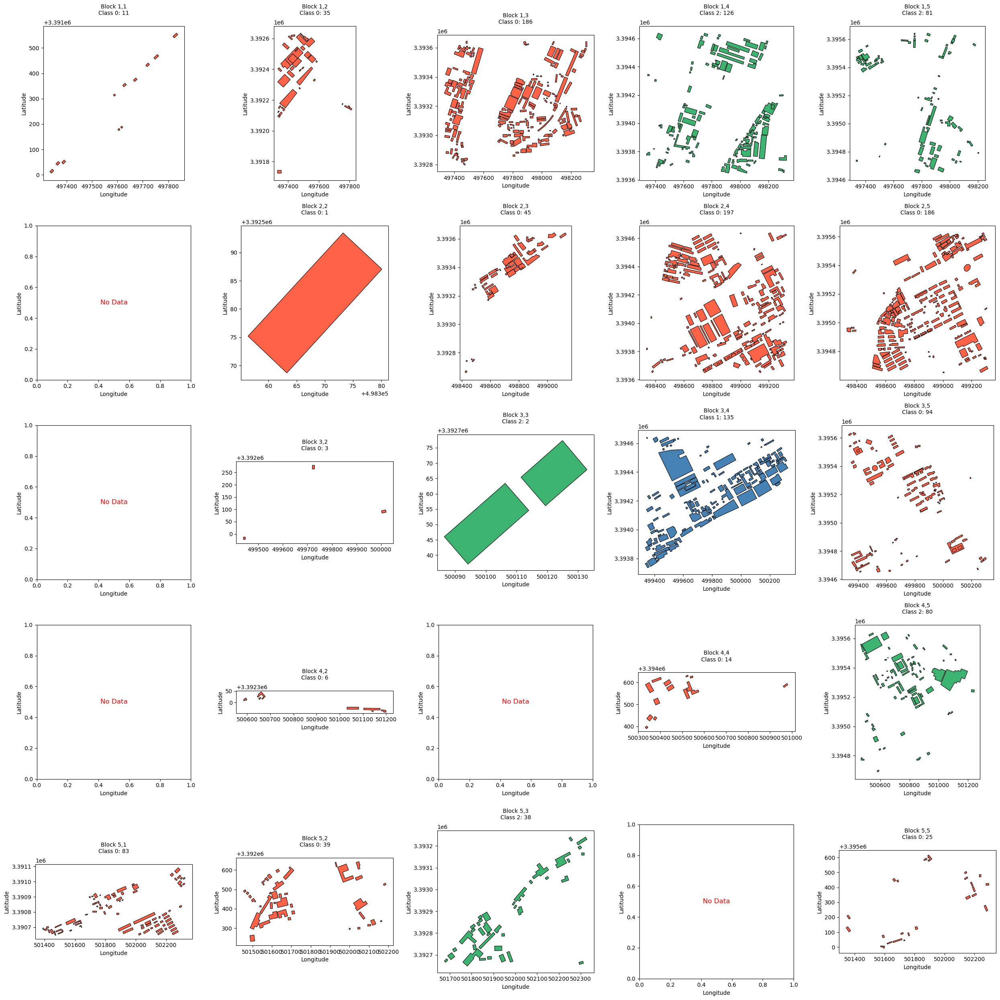

In [69]:
import matplotlib.pyplot as plt
import geopandas as gpd
import numpy as np
from matplotlib.colors import ListedColormap

# 假设已经有 y_pred 分类结果，并且 regions 包含了区域名称和边界信息

# 将分类结果映射回对应的区域
center_area['predicted_class'] = np.nan  # 初始化一个列来存储预测类别

for i, (region_name, (x_min_r, x_max_r, y_min_r, y_max_r)) in enumerate(regions):
    mask = (
        (center_area.geometry.bounds.minx >= x_min_r) &
        (center_area.geometry.bounds.maxx <= x_max_r) &
        (center_area.geometry.bounds.miny >= y_min_r) &
        (center_area.geometry.bounds.maxy <= y_max_r)
    )
    center_area.loc[mask, 'predicted_class'] = y_pred[i]

# 设置图像的大小和网格
fig, axs = plt.subplots(5, 5, figsize=(25, 25))
axs = axs.flatten()

# 使用一个自定义的颜色映射，不同的颜色代表不同的类别
cmap_dict = {
    0: '#FF6347',  # Tomato for Class 0
    1: '#4682B4',  # SteelBlue for Class 1
    2: '#3CB371'   # MediumSeaGreen for Class 2
}

# 确保每个建筑物的颜色根据其类别进行绘制
for i, (region_name, (x_min_r, x_max_r, y_min_r, y_max_r)) in enumerate(regions):
    region_ax = axs[i]
    region_area = center_area.cx[x_min_r:x_max_r, y_min_r:y_max_r]

    if not region_area.empty:
        # 对于每个类别分别绘制建筑物
        for cls, color in cmap_dict.items():
            class_area = region_area[region_area['predicted_class'] == cls]
            if not class_area.empty:
                class_area.plot(ax=region_ax, color=color, linewidth=0.8, edgecolor='black')
        
        # 统计类别并准备标注内容
        class_counts = region_area['predicted_class'].value_counts().to_dict()
        
        # 准备显示在下方的标注内容
        text_str = '\n'.join([f'Class {int(cls)}: {count}' for cls, count in class_counts.items()])
        region_ax.set_title(f"{region_name}\n{text_str}", fontsize=10, loc='center', pad=20)
    else:
        region_ax.text(0.5, 0.5, 'No Data', ha='center', va='center', fontsize=12, color='red')

    region_ax.set_aspect('equal')
    region_ax.set_xlabel("Longitude")
    region_ax.set_ylabel("Latitude")

plt.tight_layout()
plt.show()


C:\Users\asus\AppData\Roaming\Python\Python311\site-packages\geopandas\geodataframe.py:1819: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)


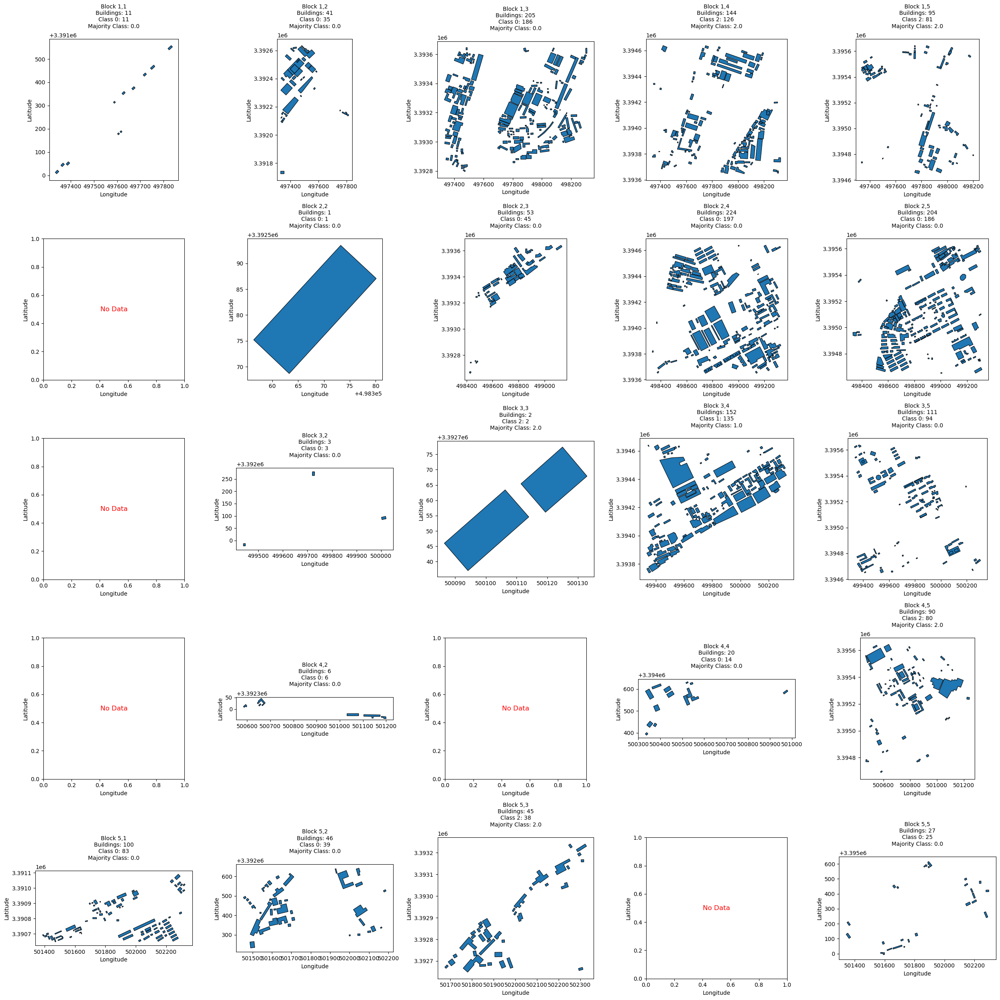

In [78]:
import matplotlib.pyplot as plt
import geopandas as gpd
import numpy as np

# 假设已经有 y_pred 分类结果，并且 regions 包含了区域名称和边界信息

# 将分类结果映射回对应的区域
center_area['predicted_class'] = np.nan  # 初始化一个列来存储预测类别

for i, (region_name, (x_min_r, x_max_r, y_min_r, y_max_r)) in enumerate(regions):
    mask = (
        (center_area.geometry.bounds.minx >= x_min_r) &
        (center_area.geometry.bounds.maxx <= x_max_r) &
        (center_area.geometry.bounds.miny >= y_min_r) &
        (center_area.geometry.bounds.maxy <= y_max_r)
    )
    center_area.loc[mask, 'predicted_class'] = y_pred[i]

# 设置图像的大小和网格
fig, axs = plt.subplots(5, 5, figsize=(25, 25))
axs = axs.flatten()

# 保持原来的颜色映射（使用tab10）
cmap = 'tab10'

for i, (region_name, (x_min_r, x_max_r, y_min_r, y_max_r)) in enumerate(regions):
    region_ax = axs[i]
    region_area = center_area.cx[x_min_r:x_max_r, y_min_r:y_max_r]

    if not region_area.empty:
        # 绘制区域内的建筑物，使用与整体图相同的颜色映射
        region_area.plot(column='predicted_class', ax=region_ax, cmap=cmap, legend=False, linewidth=0.8, edgecolor='black')
        
        # 统计建筑数量和分类信息
        building_count = len(region_area)
        class_counts = region_area['predicted_class'].value_counts().to_dict()
        majority_class = max(class_counts, key=class_counts.get)

        # 准备显示在下方的标注内容
        text_str = (f'Buildings: {building_count}\n' +
                    '\n'.join([f'Class {int(cls)}: {count}' for cls, count in class_counts.items()]) +
                    f'\nMajority Class: {majority_class}')
        
        region_ax.set_title(f"{region_name}\n{text_str}", fontsize=10, loc='center', pad=20)
    else:
        region_ax.text(0.5, 0.5, 'No Data', ha='center', va='center', fontsize=12, color='red')

    region_ax.set_aspect('equal')
    region_ax.set_xlabel("Longitude")
    region_ax.set_ylabel("Latitude")

plt.tight_layout()
plt.show()


C:\Users\asus\AppData\Roaming\Python\Python311\site-packages\geopandas\geodataframe.py:1819: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)


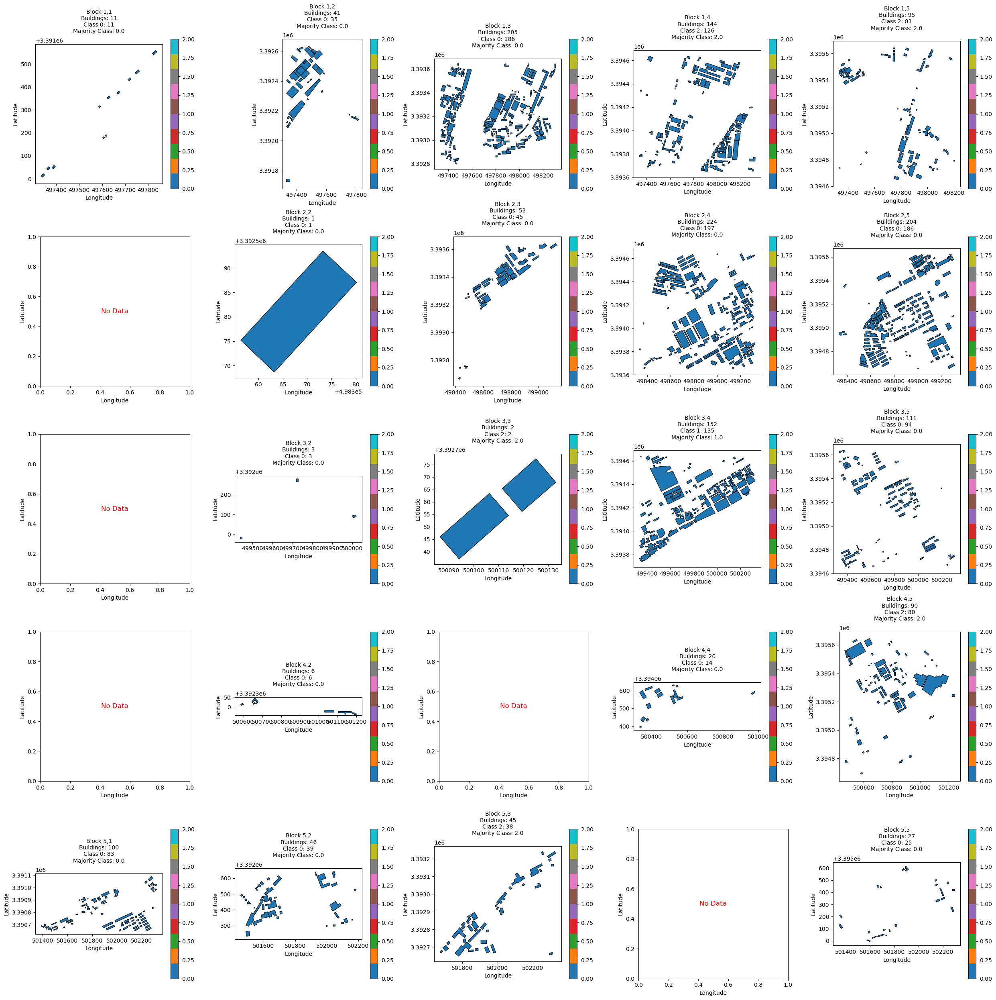

In [79]:
import matplotlib.pyplot as plt
import geopandas as gpd
import numpy as np
from matplotlib.colors import ListedColormap

# 假设已经有 y_pred 分类结果，并且 regions 包含了区域名称和边界信息

# 将分类结果映射回对应的区域
center_area['predicted_class'] = np.nan  # 初始化一个列来存储预测类别

for i, (region_name, (x_min_r, x_max_r, y_min_r, y_max_r)) in enumerate(regions):
    mask = (
        (center_area.geometry.bounds.minx >= x_min_r) &
        (center_area.geometry.bounds.maxx <= x_max_r) &
        (center_area.geometry.bounds.miny >= y_min_r) &
        (center_area.geometry.bounds.maxy <= y_max_r)
    )
    center_area.loc[mask, 'predicted_class'] = y_pred[i]

# 设置图像的大小和网格
fig, axs = plt.subplots(5, 5, figsize=(25, 25))
axs = axs.flatten()

# 保持原来的颜色映射（使用tab10）
cmap = 'tab10'

for i, (region_name, (x_min_r, x_max_r, y_min_r, y_max_r)) in enumerate(regions):
    region_ax = axs[i]
    region_area = center_area.cx[x_min_r:x_max_r, y_min_r:y_max_r]

    if not region_area.empty:
        # 绘制区域内的建筑物，使用与整体图相同的颜色映射
        plot = region_area.plot(column='predicted_class', ax=region_ax, cmap=cmap, legend=False, linewidth=0.8, edgecolor='black')
        
        # 添加颜色条
        sm = plt.cm.ScalarMappable(cmap=cmap, norm=plt.Normalize(vmin=0, vmax=2))
        sm._A = []
        cbar = plt.colorbar(sm, ax=region_ax)
        
        # 统计建筑数量和分类信息
        building_count = len(region_area)
        class_counts = region_area['predicted_class'].value_counts().to_dict()
        majority_class = max(class_counts, key=class_counts.get)

        # 准备显示在下方的标注内容
        text_str = (f'Buildings: {building_count}\n' +
                    '\n'.join([f'Class {int(cls)}: {count}' for cls, count in class_counts.items()]) +
                    f'\nMajority Class: {majority_class}')
        
        region_ax.set_title(f"{region_name}\n{text_str}", fontsize=10, loc='center', pad=20)
    else:
        region_ax.text(0.5, 0.5, 'No Data', ha='center', va='center', fontsize=12, color='red')

    region_ax.set_aspect('equal')
    region_ax.set_xlabel("Longitude")
    region_ax.set_ylabel("Latitude")

plt.tight_layout()
plt.show()


C:\Users\asus\AppData\Roaming\Python\Python311\site-packages\geopandas\geodataframe.py:1819: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)


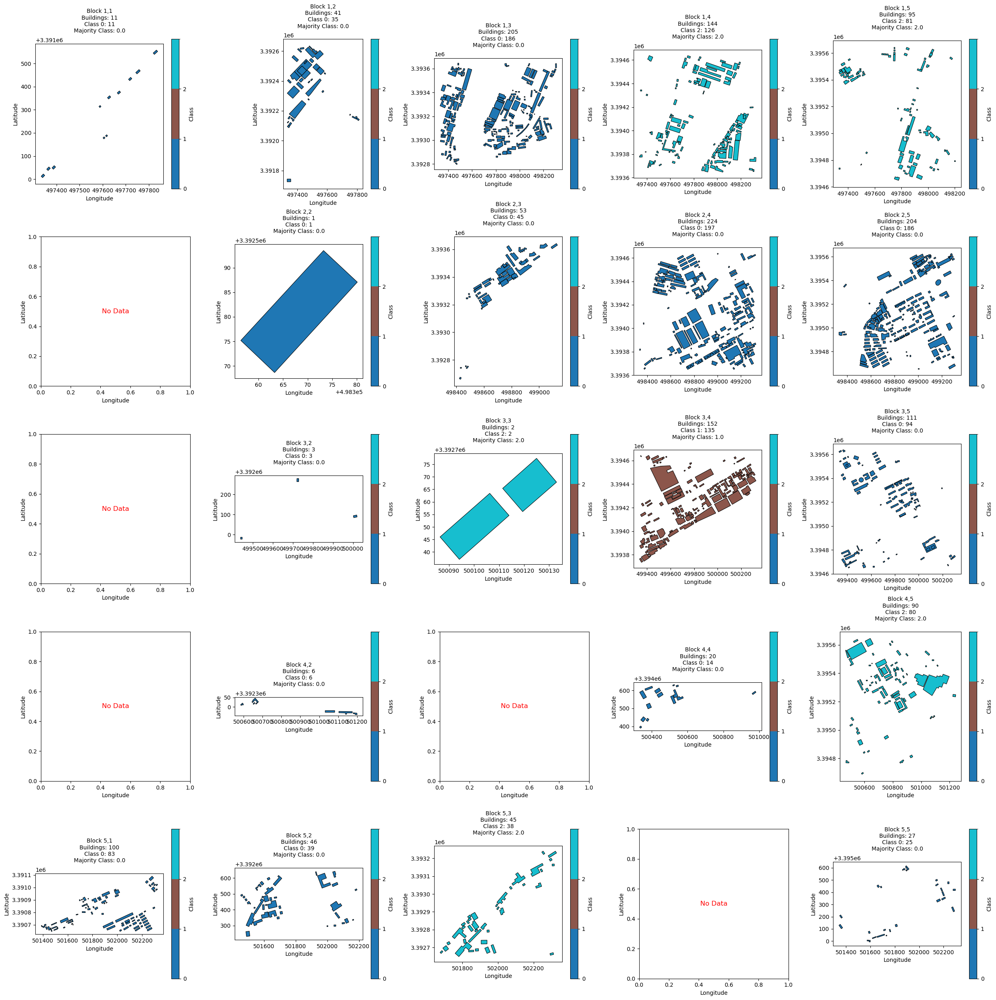

In [81]:
import matplotlib.pyplot as plt
import geopandas as gpd
import numpy as np
from matplotlib.colors import ListedColormap, BoundaryNorm

# 假设已经有 y_pred 分类结果，并且 regions 包含了区域名称和边界信息

# 将分类结果映射回对应的区域
center_area['predicted_class'] = np.nan  # 初始化一个列来存储预测类别

for i, (region_name, (x_min_r, x_max_r, y_min_r, y_max_r)) in enumerate(regions):
    mask = (
        (center_area.geometry.bounds.minx >= x_min_r) &
        (center_area.geometry.bounds.maxx <= x_max_r) &
        (center_area.geometry.bounds.miny >= y_min_r) &
        (center_area.geometry.bounds.maxy <= y_max_r)
    )
    center_area.loc[mask, 'predicted_class'] = y_pred[i]

# 设置图像的大小和网格
fig, axs = plt.subplots(5, 5, figsize=(25, 25))
axs = axs.flatten()

# 使用tab10颜色映射，并确保不同类别使用不同的颜色
cmap = plt.get_cmap('tab10', 3)  # 只映射3种颜色
norm = BoundaryNorm([0, 1, 2, 3], cmap.N)  # 确保颜色条只对应0, 1, 2

for i, (region_name, (x_min_r, x_max_r, y_min_r, y_max_r)) in enumerate(regions):
    region_ax = axs[i]
    region_area = center_area.cx[x_min_r:x_max_r, y_min_r:y_max_r]

    if not region_area.empty:
        # 绘制区域内的建筑物，确保颜色映射与类别一致
        plot = region_area.plot(column='predicted_class', ax=region_ax, cmap=cmap, norm=norm, legend=False, linewidth=0.8, edgecolor='black')
        
        # 添加颜色条，只显示0, 1, 2三个类别的颜色
        sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
        sm._A = []
        cbar = plt.colorbar(sm, ax=region_ax, ticks=[0, 1, 2])
        cbar.set_label('Class')
        
        # 统计建筑数量和分类信息
        building_count = len(region_area)
        class_counts = region_area['predicted_class'].value_counts().to_dict()
        majority_class = max(class_counts, key=class_counts.get)

        # 准备显示在下方的标注内容
        text_str = (f'Buildings: {building_count}\n' +
                    '\n'.join([f'Class {int(cls)}: {count}' for cls, count in class_counts.items()]) +
                    f'\nMajority Class: {majority_class}')
        
        region_ax.set_title(f"{region_name}\n{text_str}", fontsize=10, loc='center', pad=20)
    else:
        region_ax.text(0.5, 0.5, 'No Data', ha='center', va='center', fontsize=12, color='red')

    region_ax.set_aspect('equal')
    region_ax.set_xlabel("Longitude")
    region_ax.set_ylabel("Latitude")

plt.tight_layout()
plt.show()
